In [1]:
import scanpy as sc
import anndata as ad
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
import os
os.chdir("/dcs04/lieber/lcolladotor/spatialHPC_LIBD4035/spatial_hpc")
os.getcwd()

'/dcs04/lieber/lcolladotor/spatialHPC_LIBD4035/spatial_hpc'

In [16]:
adata_filt = ad.read_h5ad("snRNAseq_hpc/python_analysis/processed-data/adata_qc-strict_scvi-2k-hdg_processed.h5")
adata_filt.shape #74216

(74216, 30790)

In [84]:
adata_filt.obs['detailed_celltypes'] = adata_filt.obs['prelim_celltypes'].astype('str')

# GABA cell type assignment

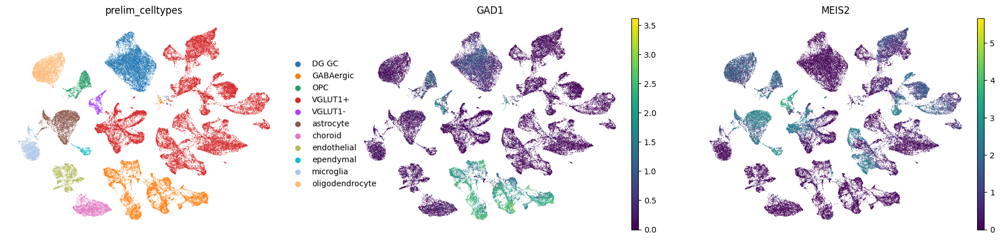

In [68]:
sc.pl.umap(adata_filt, color=["prelim_celltypes","GAD1","MEIS2"],
           ncols=3, frameon=False)

In [34]:
adata_inh = adata_filt[adata_filt.obs['prelim_celltypes']=='GABAergic']
adata_inh.shape

(9921, 30790)

GABA subtypes:
- Caudal ganglionic eminence (CGE): ADARB2+
- Medial ganglionic eminence (MGE): LHX6+
> Source: https://www.nature.com/articles/s41586-019-1506-7

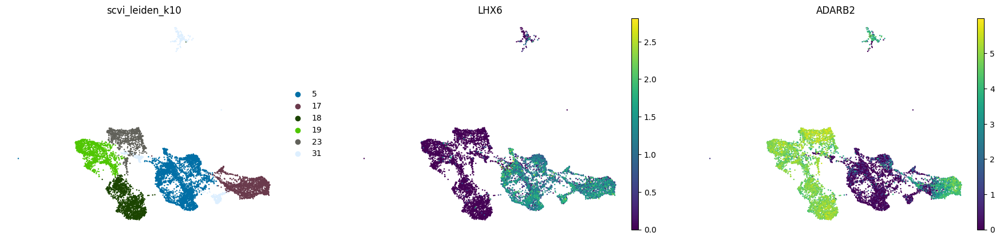

In [52]:
sc.pl.umap(adata_inh, color=["scvi_leiden_k10","LHX6","ADARB2"],
           ncols=3, frameon=False)

https://elifesciences.org/articles/85893
> "A small fraction of these MGE-derived neurogliaform cells (NGFCs) is located in the neocortex; these are the sparse deep layer Lamp5/Lhx6 cells described and characterized previously by us using intersectional genetics with Id2 (Id2-CreER; Nkx2.1-Flpo; Ai65) (Krienen et al., 2020; Valero et al., 2021)."

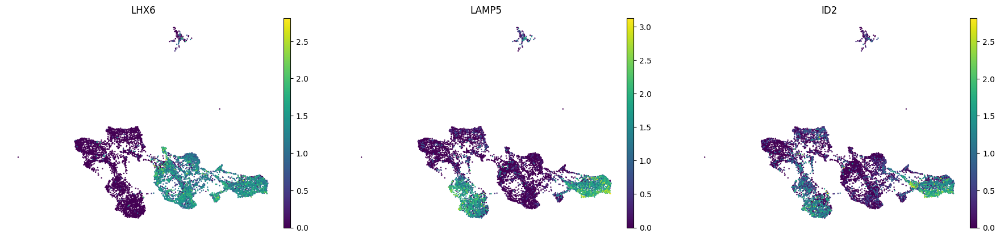

In [53]:
sc.pl.umap(adata_inh, color=["LHX6","LAMP5","ID2"],
           ncols=3, frameon=False)

Cluster 17 = neurogliaform?

In [85]:
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='17',"detailed_celltypes"] = "GABA_NGFC"

**MGE (LHX6+) branch comprises SST and PVALB interneurons.** <br>
Another good marker for PVALB population (since PVALB itself isn't well represented in our snRNAseq data, is TAC1.
> Source: https://www.nature.com/articles/s41586-018-0654-5/figures/5

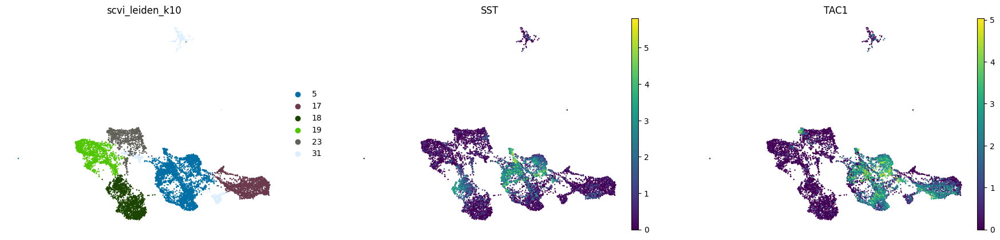

In [56]:
sc.pl.umap(adata_inh, color=["scvi_leiden_k10","SST","TAC1"],
           ncols=3, frameon=False)

Cluster 5 = MGE interneurons

In [86]:
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='5',"detailed_celltypes"] = "GABA_SST-TAC1"

**CGE (ADARB2+) branch comprises LAMP5 and VIP interneurons.** <br>
Also SERPINF1 and SNCG which aren't really represented in our data.
> Source: https://www.nature.com/articles/s41586-018-0654-5/

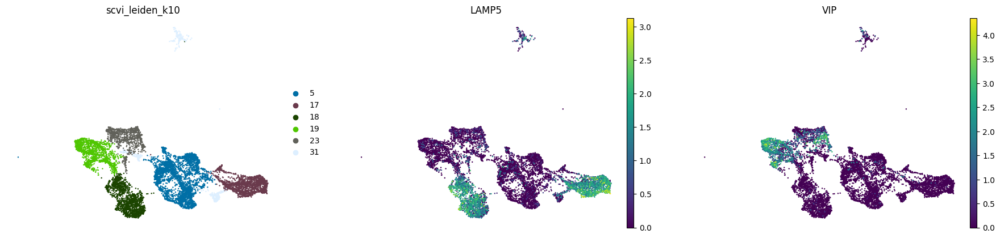

In [63]:
sc.pl.umap(adata_inh, color=["scvi_leiden_k10","LAMP5","VIP"],
           ncols=3, frameon=False)

The same source also reports that:
> "Within the Lamp5, Vip, Sncg and Serpinf1 subclasses, we find evidence for neurogliaform, bipolar, single bouquet and cholecystokinin (CCK) basket cell types (Supplementary Table 1). The Sncg subclass corresponds to the Vip+ and Cck+ multipolar or basket cells and is distinct from cells of the Vip subclass that are also Calb2+ and have bipolar morphologies (16,35,36)."

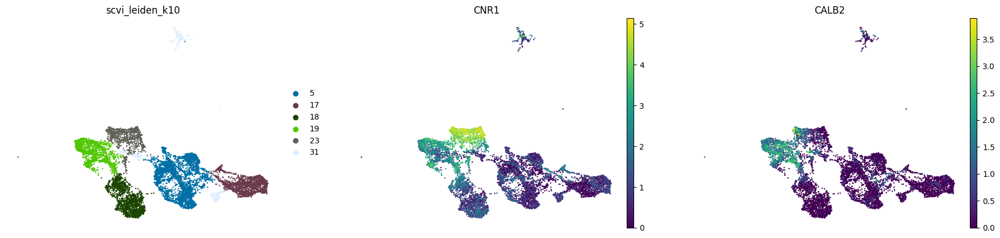

In [64]:
sc.pl.umap(adata_inh, color=["scvi_leiden_k10","CNR1","CALB2"],
           ncols=3, frameon=False)

Cluster 23 = CCK interneurons (basket cells) <br>
Cluster 19 = CALB2+ Vip interneurons (bipolar)

In [87]:
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='23',"detailed_celltypes"] = "GABA_CCK"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='19',"detailed_celltypes"] = "GABA_VIP-CALB2"

The LAMP5+ cluster also highly expresses RELN, which has been shown to be present in a population of interneurons in adulthood.
> https://pubmed.ncbi.nlm.nih.gov/9501244/

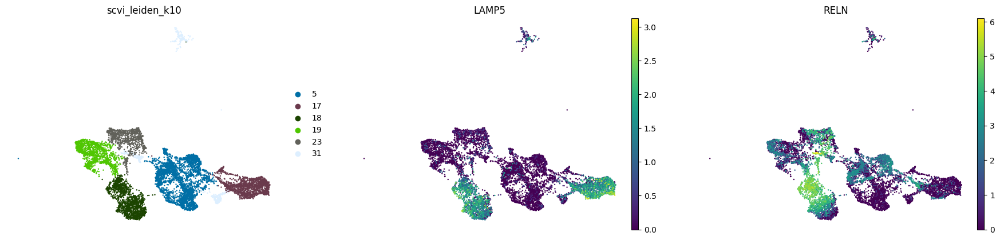

In [65]:
sc.pl.umap(adata_inh, color=["scvi_leiden_k10","LAMP5","RELN"],
           ncols=3, frameon=False)

Cluster 18 = LAMP5+ RELN+

In [88]:
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='18',"detailed_celltypes"] = "GABA_LAMP5-RELN"

In [89]:
adata_inh = adata_filt[adata_filt.obs['prelim_celltypes']=='GABAergic'].copy()

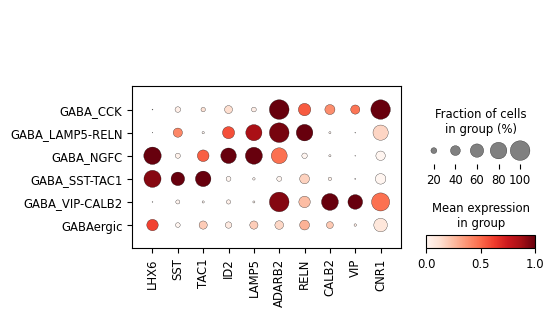

In [90]:
sc.pl.dotplot(adata_inh, 
              ['LHX6','SST','TAC1','ID2','LAMP5',
               'ADARB2','RELN','CALB2','VIP','CNR1'
              ], 
              groupby="detailed_celltypes", standard_scale="var", 
              dendrogram=False)#, figsize=(12,6))

In [91]:
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='31',"detailed_celltypes"] = "GABA_assrt"

# VGLUT1- cell type assignment

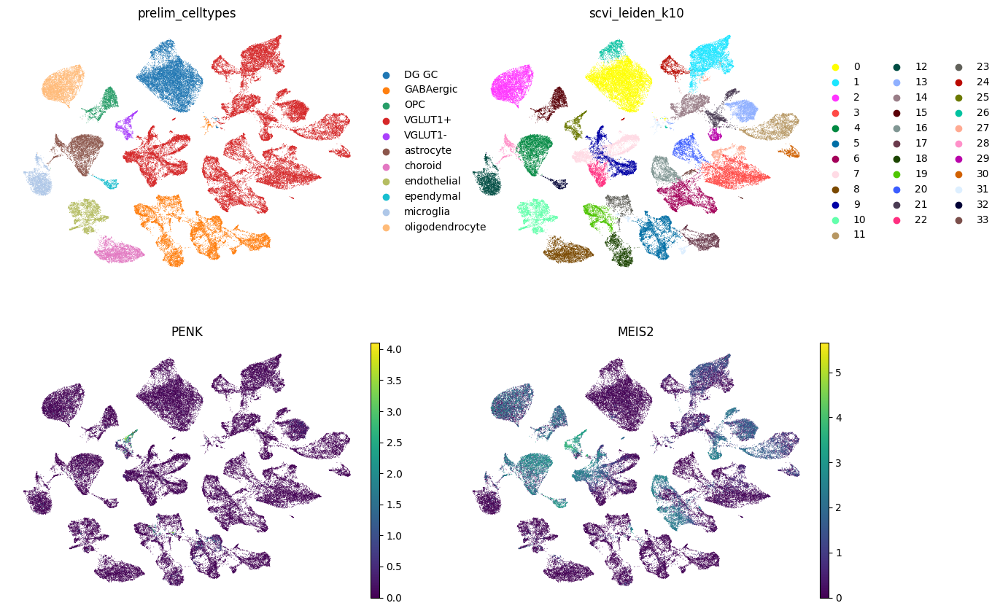

In [82]:
sc.pl.umap(adata_filt, color=["prelim_celltypes","scvi_leiden_k10","PENK","MEIS2"],
           ncols=2, frameon=False)

This study suggests these may be amygdalar inhibitory neurons (https://www.nature.com/articles/s41593-023-01469-3)
>"The intercalated amygdala (IA) and central amygdala (CEA) have been characterized in detail for their involvement in fear conditioning, and more generally, aversive and appetitive behaviors. They spanned GABA-1 to GABA-21 of the taxonomy and expressed known MSN markers (for example, Penk, Pax6, Gpr88 and Ppp1r1b)"

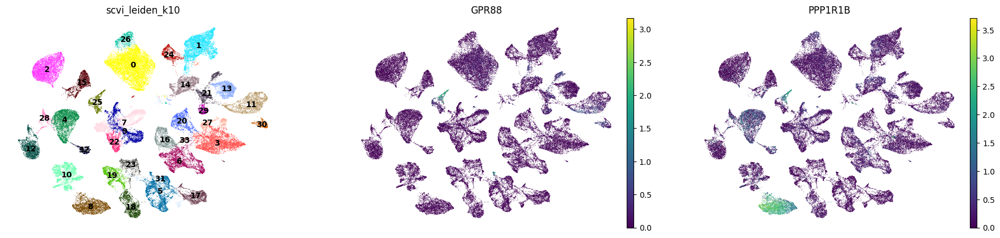

In [166]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","GPR88","PPP1R1B"],
           ncols=3, legend_loc="on data", frameon=False)

In [92]:
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='25',"detailed_celltypes"] = "PENK_MEIS2"

# VGLUT1+ cell type assignment

### Cornu ammonis

In [94]:
adata_exc = adata_filt[adata_filt.obs['prelim_celltypes']=='VGLUT1+'].copy()
adata_exc.shape

(34103, 30790)

In [ ]:
# CA1
# https://www.cell.com/neuron/fulltext/S0896-6273(21)00329-9
### Ayhan 2021 human
### CLMP, *CCBE1*, CADPS2 #FIG S7A
### THSD4, COL5A2 #TABLE S6

# https://www.nature.com/articles/s41587-022-01635-1/figures/3
### FNDC1

In [ ]:
#CA3
# https://www.cell.com/neuron/fulltext/S0896-6273(21)00866-7
### human
### these are the main markers for the following regions according to their methods
### CFAP299

# https://www.cell.com/neuron/fulltext/S0896-6273(21)00329-9
### Ayhan 2021 human
### TRHDE, TRPS1 #FIG S7A

# https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8
### YAO 2021, ADULT MOUSE
### supplemental file, hippocampal subclasses
### TSPAN18
### supplemental file, HPF gradients
### KCNG5 = CA3, subplot H

# https://www.ibroneuroscience.org/article/S0306-4522(03)00937-0/abstract
# CARTPT = mossy cells in adult humans

In [ ]:
#CA2
# https://www.cell.com/neuron/fulltext/S0896-6273(21)00866-7
### human
### these are the main markers for the following regions according to their methods
### HGF

In [ ]:
#SUB
# https://www.cell.com/neuron/fulltext/S0896-6273(21)00866-7
### human
### these are the main markers for the following regions according to their methods
### FN1 

# https://www.cell.com/neuron/fulltext/S0896-6273(21)00329-9
### Ayhan 2021 human
### FN1, FIG7A ASIC2, COL24A1, GFRA1

# https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8
### YAO 2021, ADULT MOUSE
### supplemental file, glutamatergic subclasses
### NDST4

In [153]:
sc.tl.dendrogram(adata_exc, groupby="scvi_leiden_k10", 
                 var_names=['CLMP','CCBE1','CADPS2','THSD4','COL5A2', #CA1
               'CFAP299','TRHDE','TRPS1','CARTPT', #CA3
               'HGF', #CA2
               'FN1','ASIC2','COL24A1','GFRA1','NDST4', #SUB
              ], 
                 optimal_ordering=True)

categories: 1, 3, 6, etc.
var_group_labels: CA1, CA3, SUB


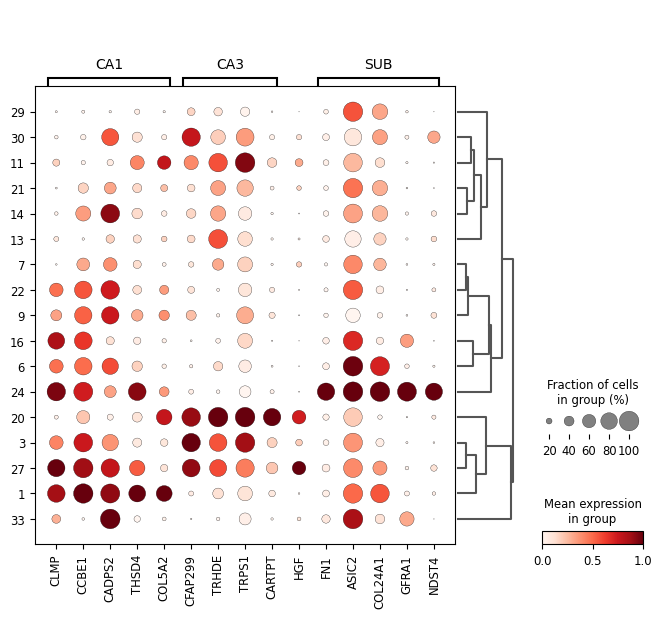

In [154]:
sc.pl.dotplot(adata_exc, 
              ['CLMP','CCBE1','CADPS2','THSD4','COL5A2', #CA1
               'CFAP299','TRHDE','TRPS1','CARTPT', #CA3
               'HGF', #CA2
               'FN1','ASIC2','COL24A1','GFRA1','NDST4' #SUB
              ], groupby="scvi_leiden_k10", standard_scale="var",
              var_group_positions=[(0,4),(5,8),(10,14)],
              var_group_labels=["CA1","CA3","SUB"],
             dendrogram=True)
              #var_group_rotation=45,
              #categories_order=scvi_order, figsize=(6,7))

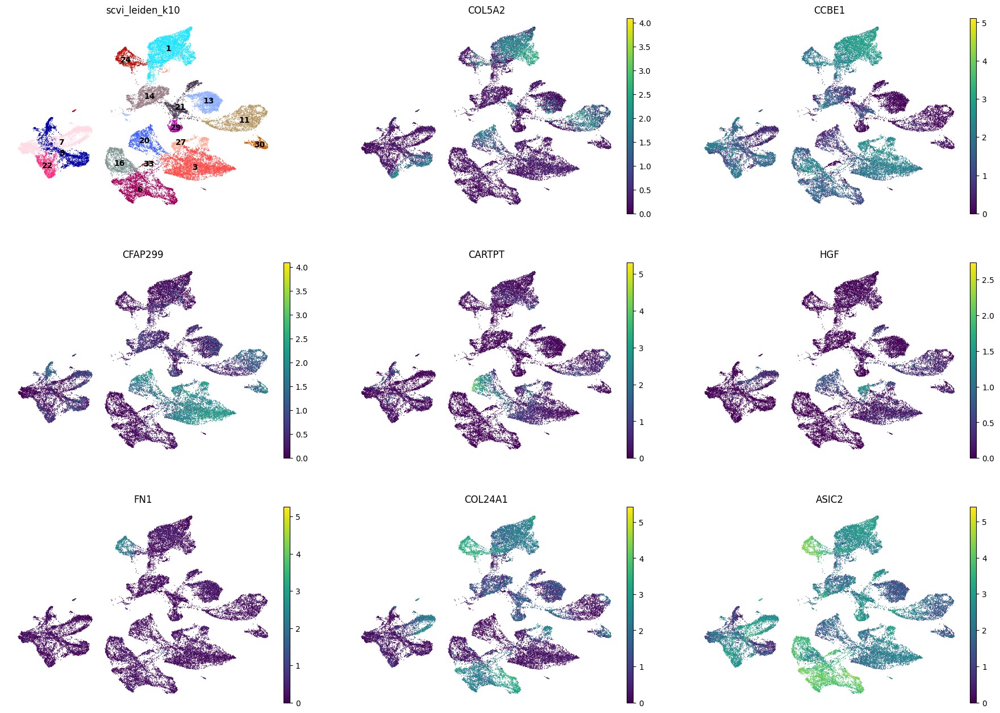

In [155]:
sc.pl.umap(adata_exc, color=["scvi_leiden_k10","COL5A2","CCBE1",
                             "CFAP299","CARTPT","HGF",
                             "FN1","COL24A1","ASIC2"],
           ncols=3, legend_loc="on data", frameon=False)

Cluster 1 = CA1 <br>
Cluster 3 = CA3, cluster 20 = mossy cells <br>
Cluster 27 = CA2 <br>
Cluster 24 = subiculum
Cluster 6 = other subiculum?
Cluster 16 = other subiculum?

In [158]:
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='1',"detailed_celltypes"] = "CA1"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='3',"detailed_celltypes"] = "CA3"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='20',"detailed_celltypes"] = "CA3_MC"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='27',"detailed_celltypes"] = "CA2"

### Amygdala (skipped)

Excitatory amygdala neurons split into two main branches, VGLUT1 and VGLUT2, which were marked by expression of Slc17a7, Slc30a3 and Tcf4, or Slc17a6, Slc6a1 and Baiap3, respectively

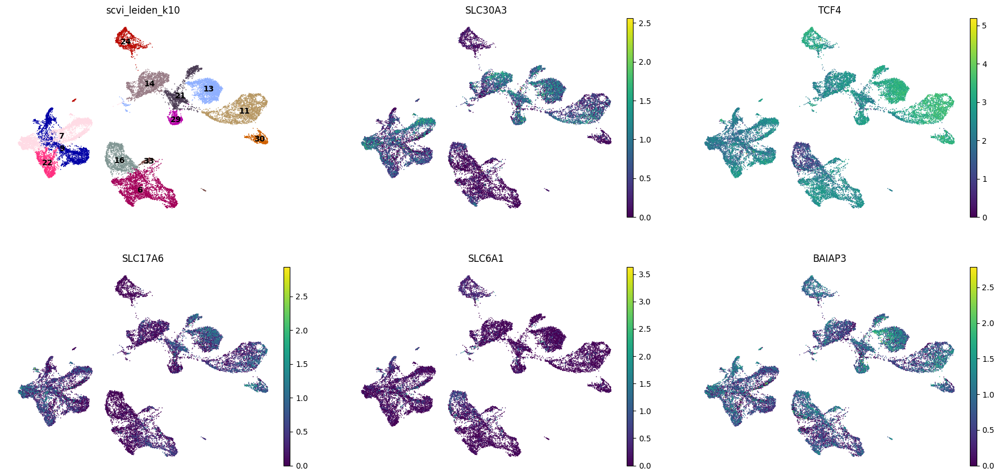

In [167]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","SLC30A3","TCF4","SLC17A6","SLC6A1","BAIAP3"],
           ncols=3, legend_loc="on data", frameon=False)

 Six VGLUT1 types (10–15) mapped to the posterior BMA (Extended Data Fig. 6). They expressed combinations of Meis2, Calb2 and Dcn, and Mpped1/Tac1, Cd36, Gpr101, Cartpt or sialyltransferase St8sia2, Ptpru and serotonin receptor Htr2c.

https://www.nature.com/articles/s41593-023-01469-3/figures/12
BLA: ZEB2 (ext Fig6)
BMA: ARHGAP6 (ext Fig6), MEIS2 (posterior), ST8SIA2 (posterior)
LA: RMST (ext Fig6)

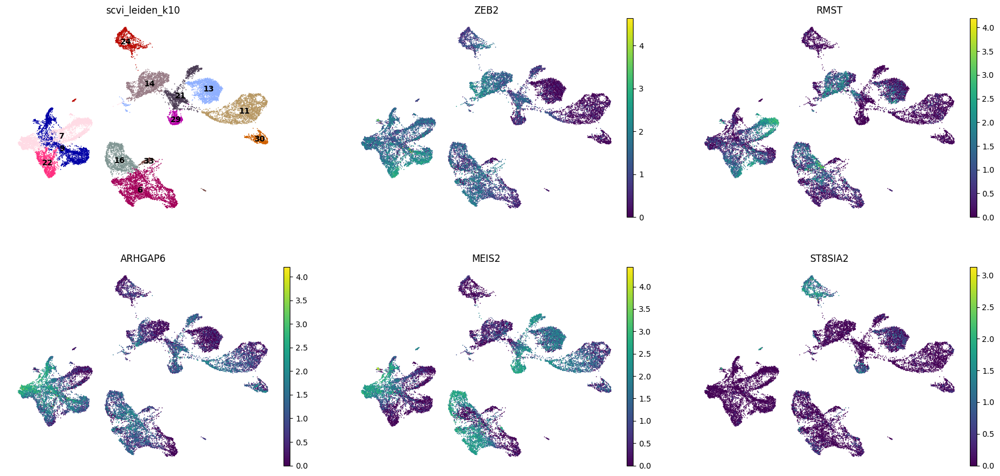

In [181]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","ZEB2","RMST","ARHGAP6","MEIS2","ST8SIA2"],
           ncols=3, legend_loc="on data", frameon=False)

### Retrohippocampal

In [303]:
adata_rhp = adata_filt[adata_filt.obs['detailed_celltypes']=="VGLUT1+"].copy()
adata_rhp.obs['detailed_celltypes'] = adata_rhp.obs['detailed_celltypes'].astype('str')
adata_rhp.shape

(22329, 30790)

Even though the previous section was about labeling CA regions, the continuity between CA1 and the subiculum drove us to explore subicular markers at the same time

In [ ]:
#SUB
# https://www.cell.com/neuron/fulltext/S0896-6273(21)00866-7
### human
### these are the main markers for the following regions according to their methods
### FN1 

# https://www.cell.com/neuron/fulltext/S0896-6273(21)00329-9
### Ayhan 2021 human
### FN1, FIG7A ASIC2, COL24A1, GFRA1

# https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8
### YAO 2021, ADULT MOUSE
### supplemental file, glutamatergic subclasses
### NDST4

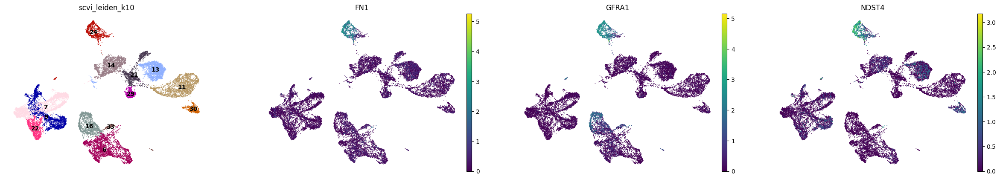

In [299]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","FN1","GFRA1","NDST4"],
           ncols=4, legend_loc="on data", frameon=False)

Cluster 24 is clearly the subiculum.

In [304]:
adata_rhp.obs.loc[adata_rhp.obs.scvi_leiden_k10=='24',"detailed_celltypes"] = "SUB"

https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8
Figure 5h = TSHZ2 is robust L4 RSP marker (as is Scnn1a and HSD11B1 which aren't present in this dataset)
The other genes reported to be enriched in this cluster are mildly expressed or absent (SLC30A3, BCL6, LYPD1, PRPH, SLCO2A1) in our dataset.
Another RSP cluster (cluster 260) expresses QRFPR which is mildly expressed in our TSHZ2 pop.
Allen brain atlas indicates that CUX2 is expressed in RSP and this cluster is mildly CUX2+.
cluster 13 = L4 RSP

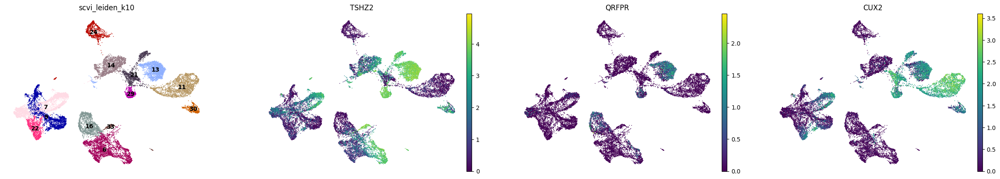

In [341]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","TSHZ2","QRFPR","CUX2"],
           ncols=4, legend_loc="on data", frameon=False)

In [305]:
adata_rhp.obs.loc[adata_rhp.obs.scvi_leiden_k10=='13',"detailed_celltypes"] = "RSP_L4"

#### Deep layer retrohippocampal pyramidal
Two sources indicate that FOXP2 and THSD7B label deep subiculum/ entorhinal cortex/ HA neurons.
1. snRNAseq, Figure S3: https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8
2. ISH, in text: https://www.cell.com/cell-reports/fulltext/S2211-1247(20)30601-X

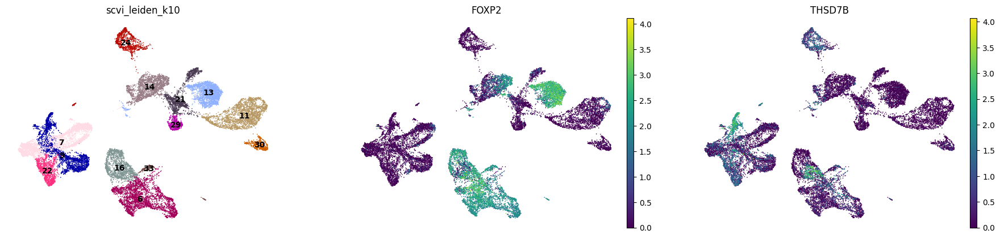

In [288]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","FOXP2","THSD7B"],
           ncols=3, legend_loc="on data", frameon=False)

Figure S3 in source 1 further demonstrates that deep layer, corticothalamic projecting neurons in both the subiculum and the entorhinal cortex express *TLE4*, but that the expression of *COL19A1* and *SEMA5B* distinguish deep EntC from SUB neurons, respectively.

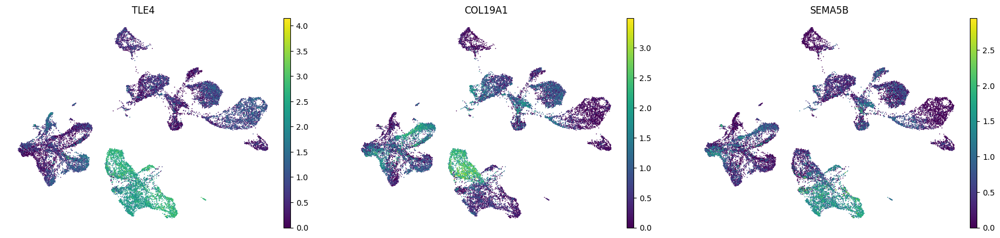

In [289]:
sc.pl.umap(adata_rhp, color=["TLE4","COL19A1","SEMA5B"],
           ncols=3, legend_loc="on data", frameon=False)

The classification of cluster 6 as subiculum is supported by the expression of Fig S7A from a [human snRNAseq study](https://www.cell.com/neuron/fulltext/S0896-6273(21)00329-9) that indicates *ASIC2* and *COL24A1* are subiculum markers.

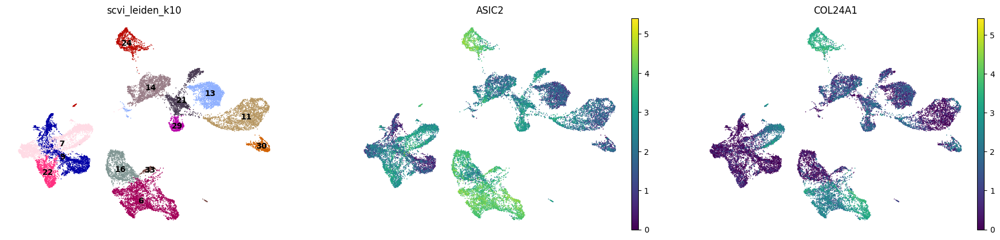

In [297]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","ASIC2","COL24A1"],
           ncols=3, legend_loc="on data", frameon=False)

Cluster 16: deep EnT pyramidal <br>
Cluster 6: deep, near projecting SUB pyramidal

In [306]:
adata_rhp.obs.loc[adata_rhp.obs.scvi_leiden_k10=='16',"detailed_celltypes"] = "EnT_deep"
adata_rhp.obs.loc[adata_rhp.obs.scvi_leiden_k10=='6',"detailed_celltypes"] = "SUB_deep"

Given the overlap of markers like FOXP2 and TLE4 with known cortical layer markers, the authors clarify that:
> "Overall, these similarities are consistent with our marker gene-based annotation of HPF clusters into corresponding layers, providing a mutual confirmation (see next section). In particular, the homology is demonstrated by a large set of canonical isocortical cell-type marker genes that show similar type and layer specificity in HPF regions, including [...] Tle4 and Foxp2 for CT/NP/L6b types."

The ISH paper additionally reports that:
> "Finally, genes expressed in the L6 (RC28 and RC29) and L6b (OC48 and OC49) of the Sub, PS, and HA often extend to the adjoining PrS (RC27, OC50) and EC. L6 cells express genes such as Sema3e, Thsd7b, Car10, and Nppc, and HA has the thickest L6, which predominantly expresses Sema3d, Foxp2, Thsd7b, and Car10 (Figures 1D, 2T, and S1F). L6b is just a single-cell layer at the gray-white matter border expressing Nxph4, Cplx3, and Ctgf."

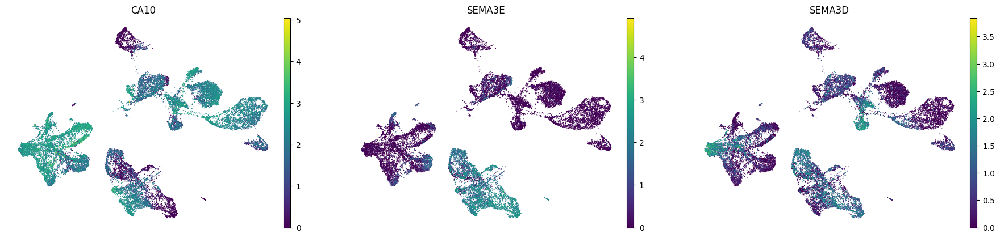

In [290]:
sc.pl.umap(adata_rhp, color=["CA10","SEMA3E","SEMA3D"],
           ncols=3, legend_loc="on data", frameon=False)

Additionally, the [snRNAseq paper](https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8) (Fig. 5D) shows there is one group of deep, corticothalamic projecting neurons collected from a joint dissection of the PAR, POST, PRE, SUB, and ProS that is noticably RORB+ and mildly TSHZ2+ and FOXP2+.<br>
None of the other markers unique to this cluster (per Fig. 5D) are present in our dataset.

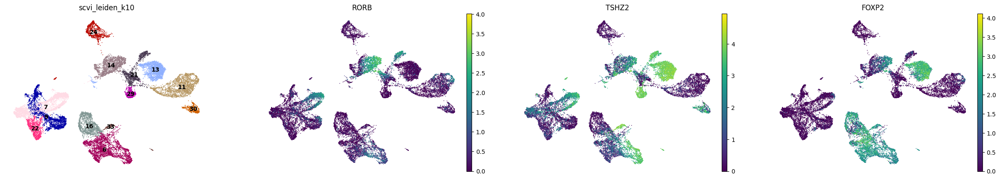

In [344]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","RORB","TSHZ2","FOXP2"], #POU6F2 comes from the  from Fig S3
           ncols=4, legend_loc="on data", frameon=False)

Cluster 14 = RORB+ PPP-SP CT subiculum

In [307]:
adata_rhp.obs.loc[adata_rhp.obs.scvi_leiden_k10=='14',"detailed_celltypes"] = "SUB_RORB"

#### CUX2+ population

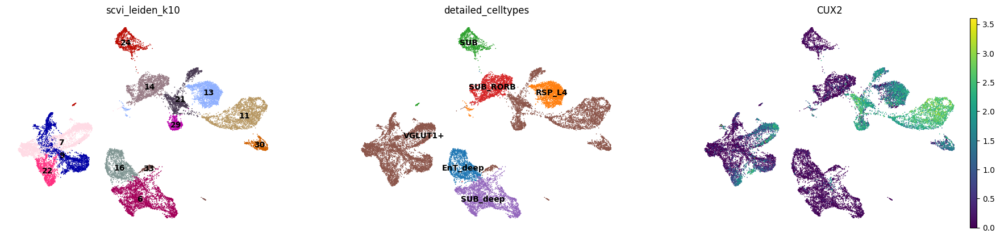

In [309]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","detailed_celltypes","CUX2"],
           ncols=3, legend_loc="on data", frameon=False)

The Allen Brain Atlas shows *CUX2* expression is strong in the adult mouse presubiculum (transition between subiculum and RSP). However, [mouse snRNAseq](https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8) data (Fig. S3) indicates *CUX2* is a L3 EnT marker. This same study showed that *PLCH1* was another L3 EnT marker.<br>
Although, *CBLN4* was labeled a prosubiculum marker based on [mouse ISH data](https://www.cell.com/cell-reports/fulltext/S2211-1247(20)30601-X) and identified a cluster in [mouse snRNAseq](https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8) (Fig. 3) as "L2/3 IT ProS", Allen Brain Atlas indicates that CBLN4 most strongly labels superficial EnT layers.

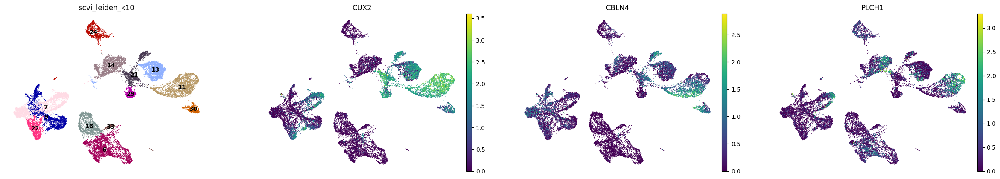

In [317]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","CUX2","CBLN4","PLCH1"],
           ncols=4, legend_loc="on data", frameon=False)

Cluster 11 = Superficial (L3) EnT

In [336]:
adata_rhp.obs['detailed_celltypes'] = adata_rhp.obs['detailed_celltypes'].astype('str')
adata_rhp.obs.loc[adata_rhp.obs.scvi_leiden_k10=='11',"detailed_celltypes"] = "EnT_sup"

cluster 29 = pre/post subiculum (transition from sub to RSP) 
CUX2+ (superficial cort); TSHZ2+ (RSP); CNTN6+ (sub far from PS/CA1 https://www.cell.com/cell-reports/fulltext/S2211-1247(20)30601-X, sub/pros ext data hpf markers https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8)

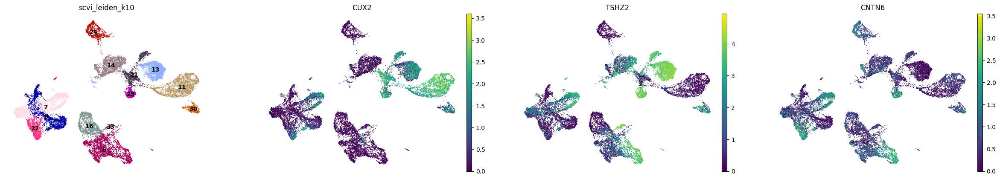

In [345]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","CUX2","TSHZ2","CNTN6"],
           ncols=4, legend_loc="on data", frameon=False)

In [347]:
adata_rhp.obs['detailed_celltypes'] = adata_rhp.obs['detailed_celltypes'].astype('str')
adata_rhp.obs.loc[adata_rhp.obs.scvi_leiden_k10=='29',"detailed_celltypes"] = "PRE-POST_SUB-RSP"

In [ ]:
# https://www.cell.com/neuron/fulltext/S0896-6273(21)00329-9
### Ayhan 2021 human
### ASIC2, COL24A1 - SUBICULUM FIG7A

# https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8
# YAO 2021, ADULT MOUSE
## supplemental file, glutamatergic subclasses
### ARHGAP6, KLHL1 = PROSUBICULUM
### CDH13 = CA1/PROSUBICULUM
### CNTN6 = SUBICULUM, PROSUBICULUM

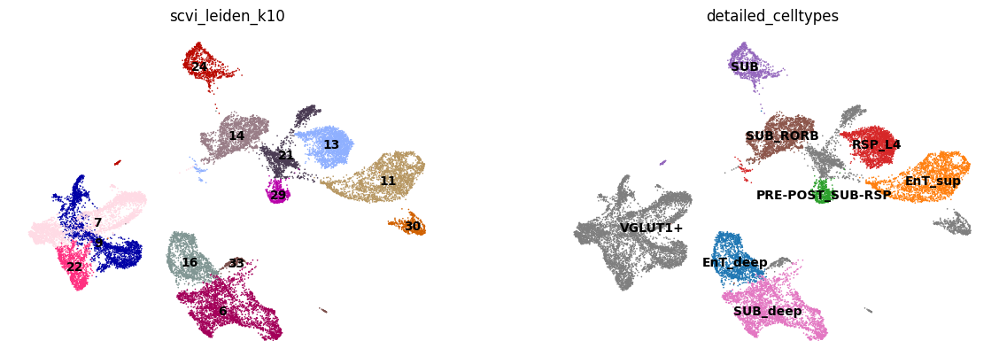

In [348]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","detailed_celltypes"],
           ncols=3, legend_loc="on data", frameon=False)

In [ ]:
#Arhgap6
# amygdala (BMA) marker: https://www.nature.com/articles/s41593-023-01469-3/figures/12
# prosubiculum marker: https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8

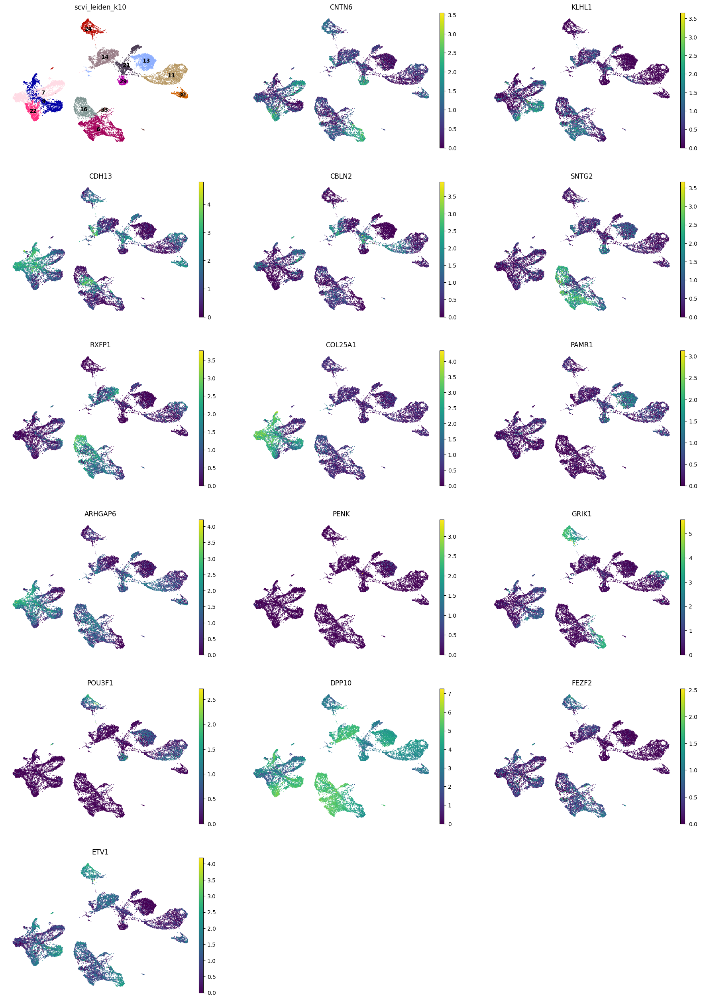

In [337]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","CNTN6","KLHL1","CDH13","CBLN2","SNTG2","RXFP1","COL25A1","PAMR1","ARHGAP6",
                            "PENK","GRIK1","POU3F1","DPP10","FEZF2","ETV1"],
           ncols=3, legend_loc="on data", frameon=False)

In [ ]:
# https://www.cell.com/cell-reports/fulltext/S2211-1247(20)30601-X
# subiculum pyramidal
### in text: St8sia2, Cntn6 (distal, away from PS)
### in text: SNTG2 (proximal, close to PS)
### Fig 2 heatmap: RXFP1 
### in text: SEMA3E (deep)

# polymorphic layer of prosubiculum or subiculum
### Fig 2 heatmap: PAMR1, CBLN2
### in text: CNTN6

#prosubiculum pyramidal
### in text: cbln4 (superficial), col25a1 (superficial, undermost superficial)

# fig S6: etv1 shows dorsal subiculum, postsub/ HATA

#HAT
### in text: THSD7B

#L6 of sub, hat, 

In [ ]:
#allen brain atlas
# cux2 strong in presubiculum
# cbln2: superficial subiculum

In [ ]:
# https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8
## figure S3
### PARM1, ETV1, FRAS1: subiculum to CA1
### CUX2: L3 isocortex entorhinal

# The PPP-SP joint region includes PAR-POST-PRE-SUB-ProS.
# The PPP IT group (Figures 4B, 4C, 4E, 4F, 4I, and 4J) contains the L2/3 IT PPP subclass and is most closely related to supertype 
### L2 IT RSP-ACA Npnt (cluster 134), consistent with the anatomical proximity of PPP and RSP. 


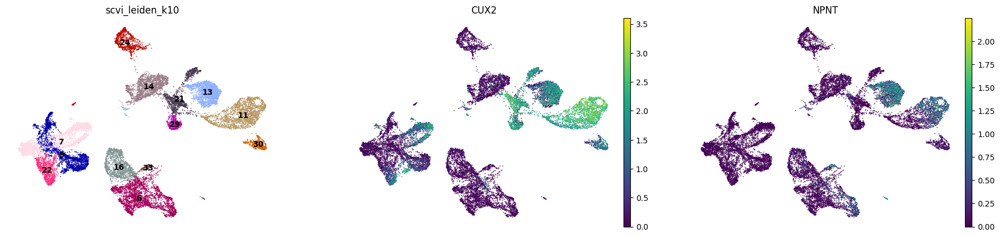

In [292]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","CUX2","NPNT"],
           ncols=4, legend_loc="on data", frameon=False)

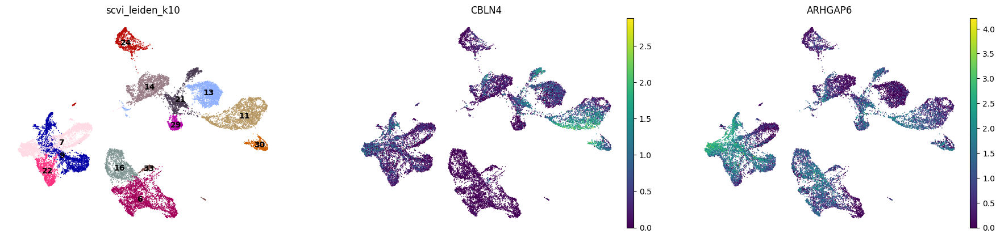

In [295]:
#Figure 3: CBLN4 = ProS; ARHGAP6 = ProS
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","CBLN4","ARHGAP6"],
           ncols=4, legend_loc="on data", frameon=False)


The L2/3 RHP subclass contains two supertypes assigned to the superficial layers of ProS (L2/3 IT ProS Dcn Cbln4, Figures 4I–4J) and HATA (IT HATA Id4, also extending to ventral ENT) regions (Ding et al., 2020). 

The PPP-SP joint region includes PAR-POST-PRE-SUB-ProS.
https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8
>"The PPP IT group (Figures 4B, 4C, 4E, 4F, 4I, and 4J) contains the L2/3 IT PPP subclass and is most closely related to supertype L2 IT RSP-ACA ***Npnt*** (cluster 134), consistent with the anatomical proximity of PPP and RSP."<br>
>"The supertypes within L2/3 IT PPP follow a rostral dorsal to caudal ventral transition (Figures 4E, 4I, and 4J), starting with the Pdlim1 supertype in L2 of RSPv, POST, and PRE, then the ***Kit*** supertype in L2/3 of POST-PRE, followed by the Wfs1 Prlr supertype in L2/3 of PAR, and the Cfap58 supertype (145) in caudal PAR."

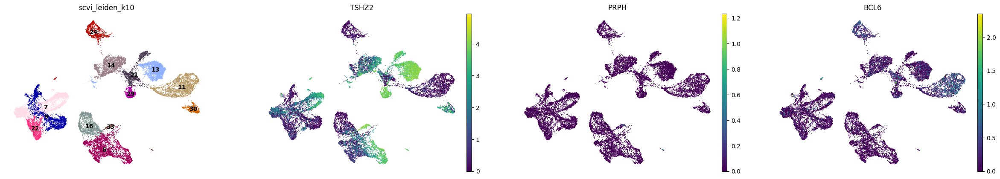

In [265]:
sc.pl.umap(adata_rhp, color=["scvi_leiden_k10","TSHZ2","PRPH","BCL6"],
           ncols=4, legend_loc="on data", frameon=False)

In [ ]:
#dpp10 ca1 and subiculum strong, guessing prosubiculum https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4084682/

In [247]:
adata_filt.var.index[[x.startswith("ERG") for x in adata_filt.var.index]]

Index(['ERGIC1', 'ERGIC2', 'ERG28', 'ERGIC3', 'ERG'], dtype='object')

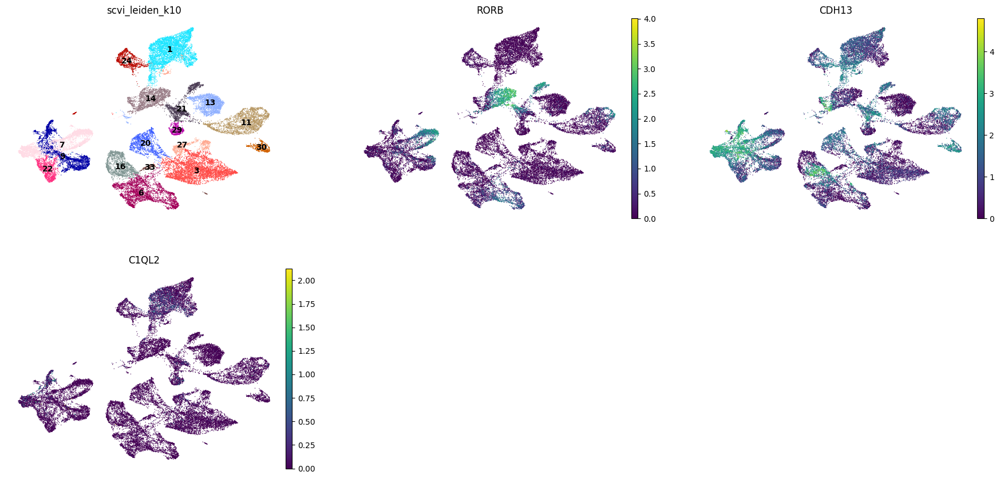

In [263]:
sc.pl.umap(adata_exc, color=["scvi_leiden_k10","RORB","CDH13","C1QL2"],
           ncols=3, legend_loc="on data", frameon=False)

In [10]:
detailed_markers = ["GAD1","LHX6","ADARB2",#MGE, CGE https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6919571/
                    "SLC17A7","PROX1",
                   "CDH22",#HAT, CDH22 Fig 4: https://www.sciencedirect.com/science/article/pii/S1567133X10000815?via%3Dihub
                   "TSPAN18",#CARTPT, #CARPTP = mossy cells
                   #"RGS14",#CA2 marker from Erik's list 
                   "MPPED1", #CA1 and cortical marker https://pubmed.ncbi.nlm.nih.gov/20503375/
                   "FNDC1",
                   #subiculum and prosubiclum, from: https://www.cell.com/cell-reports/fulltext/S2211-1247(20)30601-X
                   "CBLN2",#subiculum pyramidal superficial
                   "FN1",# subiculum pyramidal
                   "CBLN4",#Prosubiculum pyramidal, superficial
                   "RORB",#L4 https://elifesciences.org/articles/52370.pdf
                   "SATB2", #callosal projection neurons https://pubmed.ncbi.nlm.nih.gov/18255030/
                   #SATB2 superficial cortical layers Fig 1 https://www.cell.com/neuron/fulltext/S0896-6273(07)01017-3
                   #"CDH12",#Figure 6D https://www.sciencedirect.com/science/article/pii/S1567133X10000815?via%3Dihub
                   "TLE4",#corticothalamic neuron https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10542749/
]

In [14]:
scvi_order = [
    '31',#C1qL1+, should be MGE derived?
                '17',#GABA MGE-derived, LHX6 pos, also UNC5D and NTN4+, ID2, Oprm1 (mu opiod receptor), NOS1
                '5',#GABA MGE-derived, SST+, TAC1+, NPY+
                '18',#GABA RELN, MPPED1+??
    '23',#GABA CCK #also SLC17A8+
                '19', #GABA VIP CALB2
                '25', #GABA PENK, maybe CA2 neurons b/c high expr of rgs14 https://onlinelibrary.wiley.com/doi/full/10.1002/hipo.22010?saml_referrer
    '26','0',#GC
            '7','22','9',#HATA: look at PZDZ2 and ESR1 to see differences
            '3','20',#CA3, 20 is CA3 with MC
                '27',#ca2
            '1',#ca1
            '21','24',#subiculum (21 pyramidal superifical, 24 subiculum
                '30','11',#prosubiculum both, 30 is NTNG2+
    '14',#L4 (rorb)
            '13','29', #superficial cortical layers
    '16','33','6',#deep layer cortical neurons
]

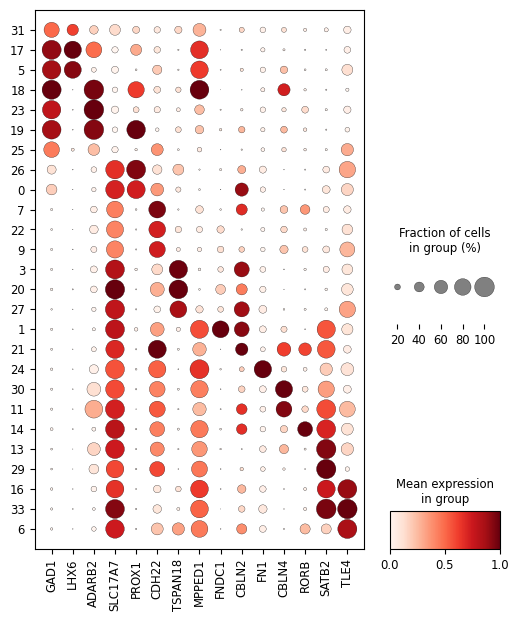

In [15]:
sc.pl.dotplot(adata_nrn, detailed_markers, groupby="scvi_leiden_k10", standard_scale="var", 
              #var_group_positions=[(0,2),(6,9),(17,22),(23,26),(27,31)],
              #var_group_labels=["GABA","Cornu Ammonis","Pro/Subiculum","Cortex"],
              #var_group_rotation=45,
              categories_order=scvi_order, figsize=(6,7))

Other potentially helpful markers: CUX2, 

In [71]:
detailed_markers = ["GAD1","LHX6","ADARB2",#MGE, CGE https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6919571/
                    "SLC17A7","PROX1",
                   "CDH22",#HAT, CDH22 Fig 4: https://www.sciencedirect.com/science/article/pii/S1567133X10000815?via%3Dihub
                   "TSPAN18","CARTPT",
                   "RGS14",#CA2 marker from Erik's list 
                    "FNDC1",
                   "MPPED1", #CA1 and cortical marker https://pubmed.ncbi.nlm.nih.gov/20503375/
                    
                    "CUX2",
                    

                    #subiculum and prosubiclum, from: https://www.cell.com/cell-reports/fulltext/S2211-1247(20)30601-X
                    "CBLN4",#Prosubiculum pyramidal, 
                    
                    "CBLN2",#SUB/ProS polymorphic
                    "RORB",# polymorphic sub,L4 https://elifesciences.org/articles/52370.pdf
                    "SEMA3D",#polymorphic (ProS)
                    "SATB2",#callosal projection neurons https://pubmed.ncbi.nlm.nih.gov/18255030/
                   #SATB2 superficial cortical layers Fig 1 https://www.cell.com/neuron/fulltext/S0896-6273(07)01017-3
                    "SAMD5",#SAMD5 ProS/Sub marker FIG S5 https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8
                    "RXFP1",#PRoS/Sub pyramidal
                    
                    
                    #"SEMA3E",#deep
                    
                    
                    "TLE4",#corticothalamic neuron https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10542749/
                    #SUB area Fig S3 https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8
                    "LRRTM3",#LRRTM3 = SUB, ProS marker (distal) FIG S5 https://www.cell.com/cell/fulltext/S0092-8674(21)00501-8
                   #"LUZP2",#LUZP2: RC4 is a small cluster with cells located in the superficial pyramidal layer of the ventral Sub bordering the PS https://www.cell.com/cell-reports/fulltext/S2211-1247(20)30601-X
                   #"PTPRK",
                    "ETV1","FN1",
                   
]

In [63]:
scvi_order = [
    '31',#C1qL1+, should be MGE derived?
                '17',#GABA MGE-derived, LHX6 pos, also UNC5D and NTN4+, ID2, Oprm1 (mu opiod receptor), NOS1
                '5',#GABA MGE-derived, SST+, TAC1+, NPY+
                '18',#GABA RELN, MPPED1+??
    '23',#GABA CCK #also SLC17A8+
                '19', #GABA VIP CALB2
                '25', #GABA PENK, maybe CA2 neurons b/c high expr of rgs14 https://onlinelibrary.wiley.com/doi/full/10.1002/hipo.22010?saml_referrer
    '26','0',#GC
            '7','22','9',#HATA: look at PZDZ2 and ESR1 to see differences
            '3','20',#CA3, 20 is CA3 with MC
                '27',#ca2
            '1',#ca1
    '11','30',#prosubiculum both, 30 is NTNG2+
            '21',#polymorphic          
    '14',#L4 (rorb)
    '29', 
            '13',#superficial cortical layers
    '33','16','6',#deep layer cortical neurons
    '24'
]

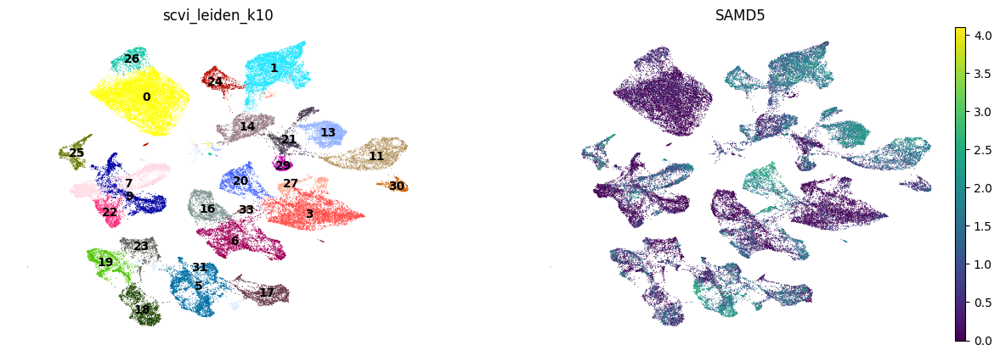

In [35]:
sc.pl.umap(adata_nrn, color=["scvi_leiden_k10","SAMD5"],
           ncols=2, legend_loc="on data", frameon=False)

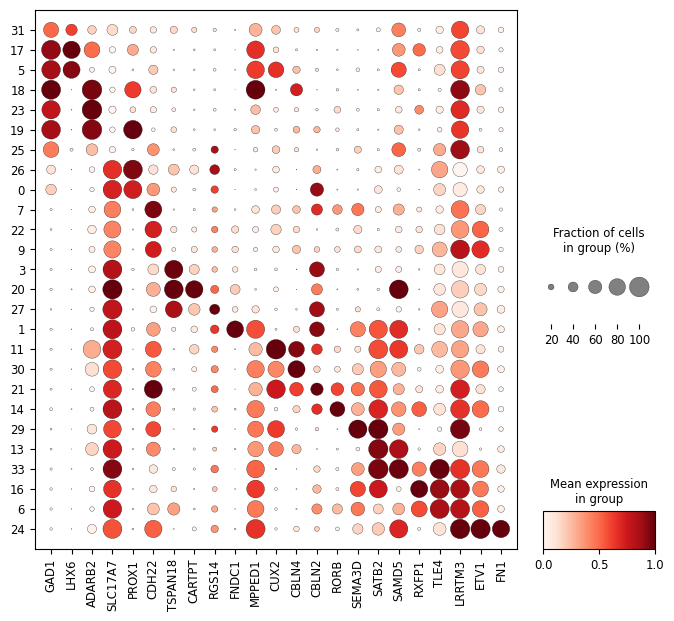

In [72]:
sc.pl.dotplot(adata_nrn, detailed_markers, groupby="scvi_leiden_k10", standard_scale="var", 
              var_group_positions=[(0,2),(6,9),(17,22),(23,26),(27,31)],
              var_group_labels=["GABA","Cornu Ammonis","Pro/Subiculum","Cortex"],
              #var_group_rotation=45,
              categories_order=scvi_order, figsize=(8,7))

In [160]:
adata_filt.obs['detailed_celltypes'] = adata_filt.obs['prelim_celltypes'].astype('str')

In [161]:
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='31',"detailed_celltypes"] = "GABA_1"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['17','5']),"detailed_celltypes"] = "GABA_mge"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['18','19','23']),"detailed_celltypes"] = "GABA_cge"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='25',"detailed_celltypes"] = "GABA_2"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['0','26']),"detailed_celltypes"] = "GC"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['7','22','9']),"detailed_celltypes"] = "HAT"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['3','20']),"detailed_celltypes"] = "CA3"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='27',"detailed_celltypes"] = "CA2"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='1',"detailed_celltypes"] = "CA1"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['21','24']),"detailed_celltypes"] = "Sub"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['11','30']),"detailed_celltypes"] = "ProS"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='14',"detailed_celltypes"] = "Pyr_L4"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['13','29']),"detailed_celltypes"] = "Pyr_superficial"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['16','6','33']),"detailed_celltypes"] = "Pyr_deep"

In [ ]:
detailed_markers2 = [
                   #other GABA markers: NXPH1, GRIK1, RELN, ADARB2, RGS12, CNR1 are all from Ayhan
                   # I added C1QL1, LHX6, TAC1 based on this paper/figure https://www.nature.com/articles/s41586-018-0654-5/figures/5
                   ### more on TAC1 C1QL1 https://www.nature.com/articles/s41467-020-20328-4
                   # I added SST, CCK, ID2, NPY
                   "LHX6","C1QL1","ID2","NOS1","SST","NPY","TAC1",
                   ##"GRIK1",
                   "RELN",
                   ##"ADARB2", "RGS12",
                   "VIP","CALB2","CCK","CNR1","PENK",
                   #PENK https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8210463/
                    "SLC17A7","PROX1",
                   "CDH22","OPRM1",#HAT, CDH22 Fig 4: https://www.sciencedirect.com/science/article/pii/S1567133X10000815?via%3Dihub
                   #"KCNQ5",
                   "TSPAN18","CARTPT",#CA3 markers from Erik's list
                   "RGS14",#CA2 marker from Erik's list 
                   #"MPPED1", #CA1 and cortical marker https://pubmed.ncbi.nlm.nih.gov/20503375/
                   "FNDC1","FIBCD1","COL5A2",#CA1 markers from Erik's list
                   #subiculum and prosubiclum, from: https://www.cell.com/cell-reports/fulltext/S2211-1247(20)30601-X
                   "CBLN2",#subiculum pyramidal superficial
                   "FN1",# subiculum pyramidal
                    "NTNG2",#prosubiculum
                   "CBLN4",#Prosubiculum pyramidal, superficial
                   "RORB",#L4 https://elifesciences.org/articles/52370.pdf
                   "SATB2", #callosal projection neurons https://pubmed.ncbi.nlm.nih.gov/18255030/
                   #SATB2 superficial cortical layers Fig 1 https://www.cell.com/neuron/fulltext/S0896-6273(07)01017-3
                   "CDH12",#Figure 6D https://www.sciencedirect.com/science/article/pii/S1567133X10000815?via%3Dihub
                   "TLE4",#corticothalamic neuron https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10542749/
                   "TBR1",
]

In [106]:
adata_filt.obs['detailed_celltypes2'] = adata_filt.obs['detailed_celltypes'].astype('str')

In [107]:
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='28',"detailed_celltypes2"] = "astrocyte_2"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='31',"detailed_celltypes"] = "GABA_C1QL1"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='17',"detailed_celltypes"] = "GABA_MGE_ID2.NOS1"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='5',"detailed_celltypes"] = "GABA_MGE_SST.TAC1.NPY"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='18',"detailed_celltypes"] = "GABA_RELN"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='19',"detailed_celltypes"] = "GABA_VIP.CALB2"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='23',"detailed_celltypes"] = "GABA_CCK"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='25',"detailed_celltypes"] = "GABA_PENK"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='26',"detailed_celltypes2"] = "GC"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='0',"detailed_celltypes2"] = "GC_active"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='7',"detailed_celltypes2"] = "HAT_1"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='22',"detailed_celltypes2"] = "HAT_2"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='9',"detailed_celltypes2"] = "HAT_3"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='3',"detailed_celltypes2"] = "CA3"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='20',"detailed_celltypes2"] = "CA3_MC"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='21',"detailed_celltypes2"] = "Sub_CBLN2"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='24',"detailed_celltypes2"] = "Sub_FN1"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='11',"detailed_celltypes2"] = "ProS"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='30',"detailed_celltypes2"] = "ProS_NTNG2"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='13',"detailed_celltypes2"] = "Pyr_sup1"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='29',"detailed_celltypes2"] = "Pyr_sup2"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='16',"detailed_celltypes2"] = "Pyr_deep1"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='6',"detailed_celltypes2"] = "Pyr_deep2"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='33',"detailed_celltypes2"] = "Pyr_deep3"

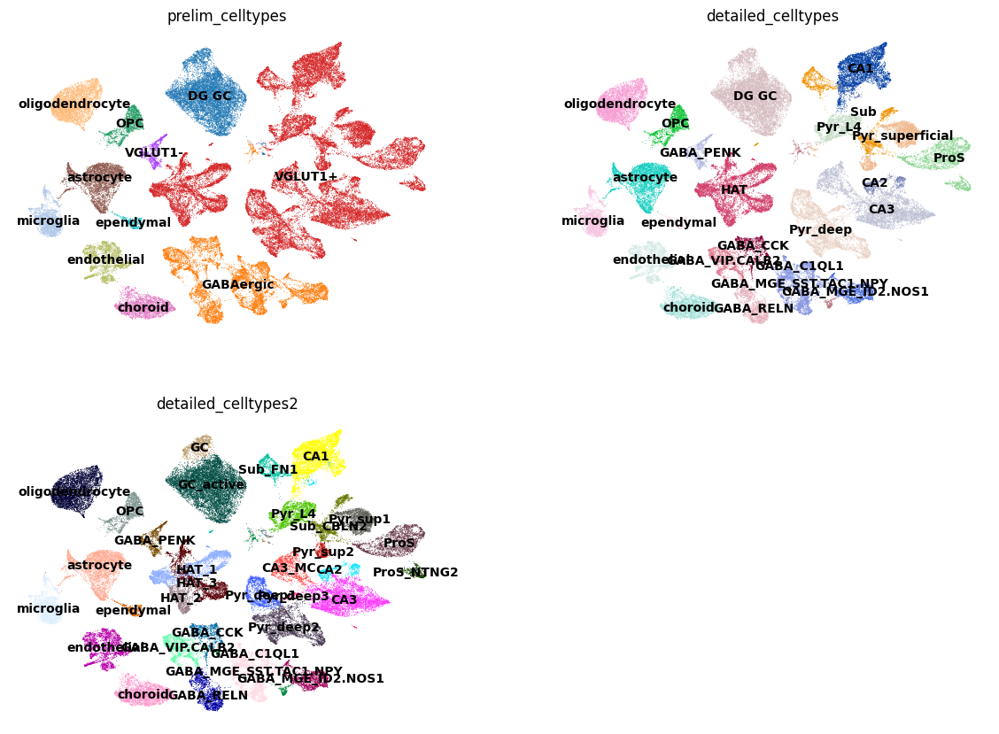

In [78]:
sc.pl.umap(adata_filt, color=["prelim_celltypes","detailed_celltypes","detailed_celltypes2"], ncols=2, legend_loc="on data", frameon=False)

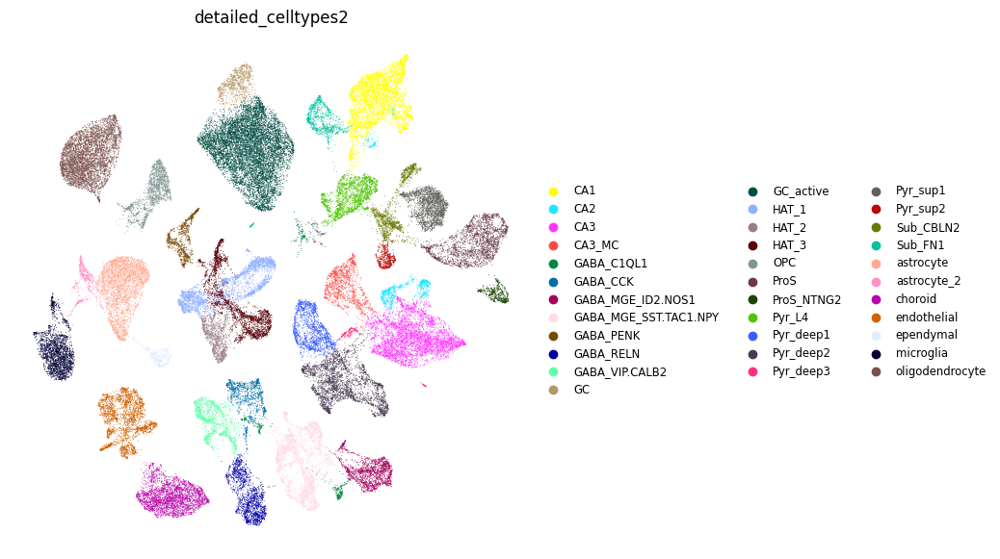

In [108]:
with plt.rc_context({"figure.figsize": (7, 7)}):
    sc.pl.umap(adata_filt, color=["detailed_celltypes2"], legend_fontsize="small",
               ncols=1, frameon=False)

In [80]:
adata_filt.obs

,barcode,key,sample,tissue,brnum,round,sorted,id,dx,race,...,_scvi_batch,_scvi_labels,scvi_leiden,scvi_leiden_k10,prelim_celltypes,EN_final,detailed_celltypes,mid_cell_class,fine_cell_class,detailed_celltypes2
key,,,,,,,,,,,,,,,,,,,,,
1c-scp-AAACGAAAGGTGAGCT-1,AAACGAAAGGTGAGCT-1,1c-scp-AAACGAAAGGTGAGCT-1,1c-scp,HPC-PI,Br8325,R0,PI,1645,Control,CAUC,...,0,0,14,12,microglia,True,microglia,Micro/Macro/T,Micro/Macro/T,microglia
1c-scp-AAACGAACACAAAGTA-1,AAACGAACACAAAGTA-1,1c-scp-AAACGAACACAAAGTA-1,1c-scp,HPC-PI,Br8325,R0,PI,1645,Control,CAUC,...,0,0,2,2,oligodendrocyte,True,oligodendrocyte,Oligo,Oligo,oligodendrocyte
1c-scp-AAACGAACAGGGACTA-1,AAACGAACAGGGACTA-1,1c-scp-AAACGAACAGGGACTA-1,1c-scp,HPC-PI,Br8325,R0,PI,1645,Control,CAUC,...,0,0,2,2,oligodendrocyte,True,oligodendrocyte,Oligo,Oligo,oligodendrocyte
1c-scp-AAACGAAGTTTCGTTT-1,AAACGAAGTTTCGTTT-1,1c-scp-AAACGAAGTTTCGTTT-1,1c-scp,HPC-PI,Br8325,R0,PI,1645,Control,CAUC,...,0,0,14,12,microglia,False,microglia,none,none,microglia
1c-scp-AAACGAATCGACGCGT-1,AAACGAATCGACGCGT-1,1c-scp-AAACGAATCGACGCGT-1,1c-scp,HPC-PI,Br8325,R0,PI,1645,Control,CAUC,...,0,0,21,17,GABAergic,True,GABA_MGE_ID2.NOS1,InhN,GABA.LAMP5,GABA_MGE_ID2.NOS1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39c-scp-TTTGGTTAGCGTATAA-1,TTTGGTTAGCGTATAA-1,39c-scp-TTTGGTTAGCGTATAA-1,39c-scp,HPC-PI+NeuN+,Br2720,R5,PI+NeuN+,825,Control,CAUC,...,0,0,0,0,DG GC,True,DG GC,ExcN,GC,GC_active
39c-scp-TTTGGTTTCAGAGCAG-1,TTTGGTTTCAGAGCAG-1,39c-scp-TTTGGTTTCAGAGCAG-1,39c-scp,HPC-PI+NeuN+,Br2720,R5,PI+NeuN+,825,Control,CAUC,...,0,0,0,0,DG GC,True,DG GC,ExcN,GC,GC_active
39c-scp-TTTGTTGAGTATGGCG-1,TTTGTTGAGTATGGCG-1,39c-scp-TTTGTTGAGTATGGCG-1,39c-scp,HPC-PI+NeuN+,Br2720,R5,PI+NeuN+,825,Control,CAUC,...,0,0,0,0,DG GC,True,DG GC,ExcN,GC,GC_active


In [ ]:
adata_filt.write_h5ad("snRNAseq_hpc/python_analysis/processed-data/adata_qc-strict_scvi-2k-hdg_processed.h5")

# Compare to Erik's assignment

In [3]:
import seaborn as sns
import numpy as np

In [4]:
adata_filt = ad.read_h5ad("snRNAseq_hpc/python_analysis/processed-data/adata_qc-strict_scvi-2k-hdg_processed.h5")
adata_filt.shape #74216

(74216, 30790)

In [21]:
adata_filt.obs.shape

(74216, 37)

In [15]:
mdata = pd.read_csv("snRNAseq_hpc/python_analysis/processed-data/colData_EN-final.csv", index_col=2)
mdata.shape

(75411, 131)

In [6]:
adata_filt.obs['EN_final'] = adata_filt.obs.index.isin(mdata.index)
sum(adata_filt.obs['EN_final'])

64251

In [16]:
mdata['adata'] = mdata.index.isin(adata_filt.obs.index)
sum(mdata['adata'])

64251

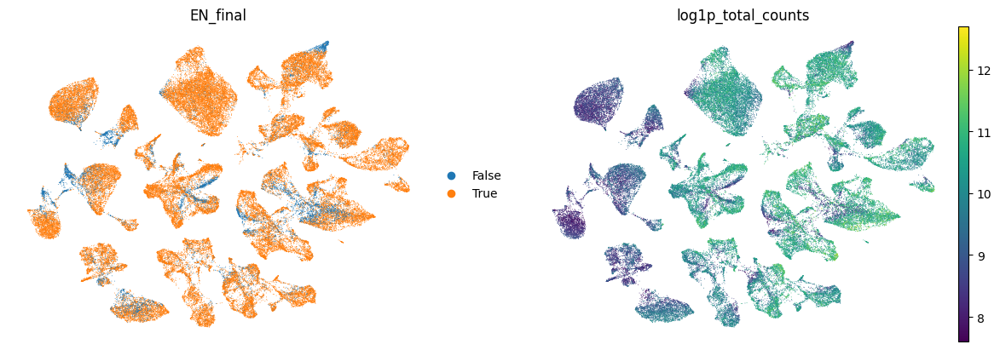

In [8]:
sc.pl.umap(adata_filt, color=["EN_final","log1p_total_counts"],
           ncols=2, frameon=False)

In [8]:
i1 = mdata[mdata.adata].index
i2 = adata_filt.obs[adata_filt.obs.EN_final].index

In [118]:
set(i1)==set(i2)

True

In [9]:
adata_filt.obs.loc[i1,'mid_cell_class'] = mdata.loc[i1,"mid.cell.class"]
adata_filt.obs.loc[i1,'fine_cell_class'] = mdata.loc[i1,"fine.cell.class"].astype('str')
#adata_filt.obs.loc[i1,'k_5_louvain'] = mdata.loc[i1,"k_5_louvain"].astype('str')

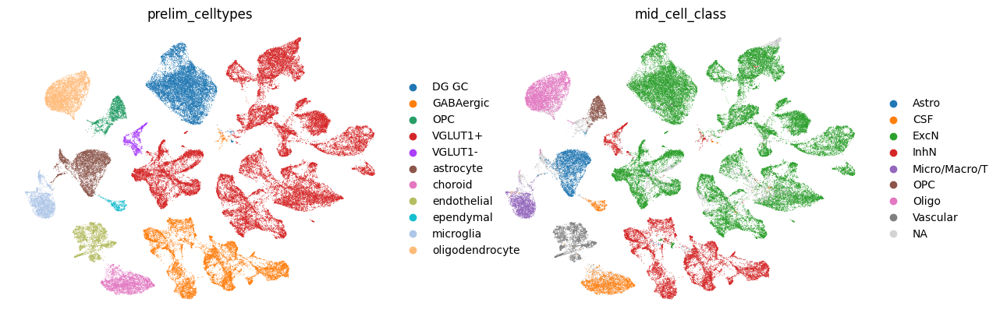

In [34]:
sc.pl.umap(adata_filt, color=["prelim_celltypes","mid_cell_class"],
           ncols=2, #legend_loc="on data", 
           frameon=False)

In [73]:
#adata_filt.obs.loc[adata_filt.obs.EN_final,'mid_cell_class'] = mdata[mdata.adata]["mid.cell.class"]
#adata_filt.obs.loc[adata_filt.obs.EN_final,'k_5_louvain'] = mdata[mdata.adata]["k_5_louvain"].astype('str')

In [21]:
mdata['scvi_leiden_k10'] = "removed"
mdata.loc[i1,'scvi_leiden_k10'] = ["c"+x for x in adata_filt.obs.loc[i1,"scvi_leiden_k10"]]

In [22]:
test_df = mdata.groupby(["fine.cell.class","scvi_leiden_k10"], observed=True).size().to_frame("n_cells")
test_df['log_cells'] = np.log10(test_df['n_cells'])
pivot = pd.pivot_table(test_df, values="log_cells",index=["scvi_leiden_k10"], columns=["fine.cell.class"], fill_value=0)

In [28]:
r_ordered = ["c29","c13","c14","c21","c11","c30","c33","c6","c16","c24",
              "c1","c27","c3","c20","c26","c0","c9","c22","c7",
              "c25","c18","c17","c19","c23","c5","c31",
              "c12","c10","c32","c8","c15","c2","c4","c28",
            "removed"]

In [29]:
c_ordered = ["Astro", "Oligo", "OPC", "Choroid", "Ependy", "Vascular", "Micro/Macro/T",
              "Thal","GABA.MGE", "GABA.CGE", "GABA.LAMP5", "GABA.PENK",
              "Amy","HATA", "GC", "CA2-4", "CA1/ProS", "Sub.1",
            "L6/6b", "Sub.2", "L2/3.PrS.Ent", "L5/6", "L2/3.PrS.PaS",
             ]

In [25]:
pivot.columns

Index(['Amy', 'Astro', 'CA1/ProS', 'CA2-4', 'Cajal', 'Choroid', 'Ependy',
       'GABA.CGE', 'GABA.LAMP5', 'GABA.MGE', 'GABA.PENK', 'GC', 'HATA',
       'L2/3.PrS.Ent', 'L2/3.PrS.PaS', 'L5/6', 'L6/6b', 'Micro/Macro/T', 'OPC',
       'Oligo', 'Sub.1', 'Sub.2', 'Thal', 'Vascular'],
      dtype='object', name='fine.cell.class')

<Axes: xlabel='fine.cell.class', ylabel='scvi_leiden_k10'>

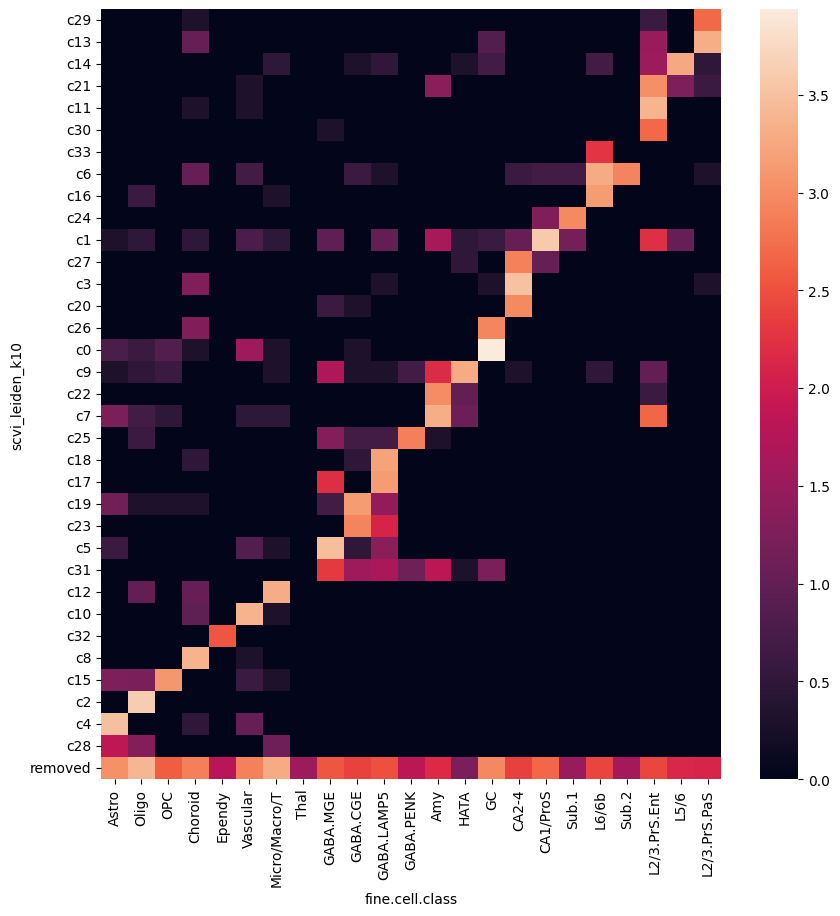

In [32]:
fig, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(pivot.loc[r_ordered,c_ordered])

In [162]:
adata_nrn2 = adata_filt[adata_filt.obs['mid_cell_class'].isin(['InhN','DG GC','ExcN'])]
adata_nrn2

View of AnnData object with n_obs × n_vars = 48329 × 30790
    obs: 'barcode', 'key', 'sample', 'tissue', 'brnum', 'round', 'sorted', 'id', 'dx', 'race', 'sex', 'age', 'pmi', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'rnd_br_sort', '_scvi_batch', '_scvi_labels', 'scvi_leiden', 'scvi_leiden_k10', 'prelim_celltypes', 'EN_final', 'k_5_louvain', 'mid_cell_class', 'detailed_celltypes'
    var: 'n_cells', 'highly_deviant'
    uns: 'dendrogram_prelim_celltypes', 'dendrogram_scvi_leiden_k10', 'log1p', 'prelim_celltypes_colors', 'scvi_leiden_k10_colors', 'EN_final_colors', 'mid_cell_class_colors', 'k_5_louvain_colors'
    obsm: 'X_umap', '_scvi_

In [124]:
adata_nrn2.obs.groupby('k_5_louvain',observed=True).size()
# c4 (thalamus) = 1 nucleus, 
#55 = 96 nuclei, 58 (cajal) = 36 nuclei, 61 (Ahi.4) = 71 nuclei

k_5_louvain
3     1459
4        1
5     1681
7      211
10    1538
11    3336
12    3864
13    2085
14     838
15     195
16    1320
18    1085
21     901
22     857
25     961
26    3171
28    1965
29    1446
31    3012
32    1861
33    1142
35    1443
37    1370
38     511
39     692
40     878
43     242
45     335
46    1432
49    1484
50     490
51     513
52     117
53    1965
54     811
55      96
56     239
57     898
58      36
59     783
60     994
61      71
dtype: int64

In [125]:
adata_nrn2 = adata_nrn2[adata_nrn2.obs['k_5_louvain']!="4"]

In [153]:
clus_order_focused = [
    '7','3','56','16','10','52',#GABA lhx6 aka mge
    '18','39','40','29',#GABA adarb2 aka CGE
    '59',#GABA PENK
    '33','12','31','49','55',#GCs
    '37','57','46','60','53',#AHI/HAT
    '11','21','38','61',#CA3
    '45',#CA2
    '26','14',#CA1
    '43',#sub cbln2 and pros ntng2
    '25',#sub fn1
    '50','54','28',#pros cbln4
    '5',#l4
    '13','51',#pyr superficial
    '35',#pyr mix
    '22','32','15',#pyr deep
    '58' #Cajal
]

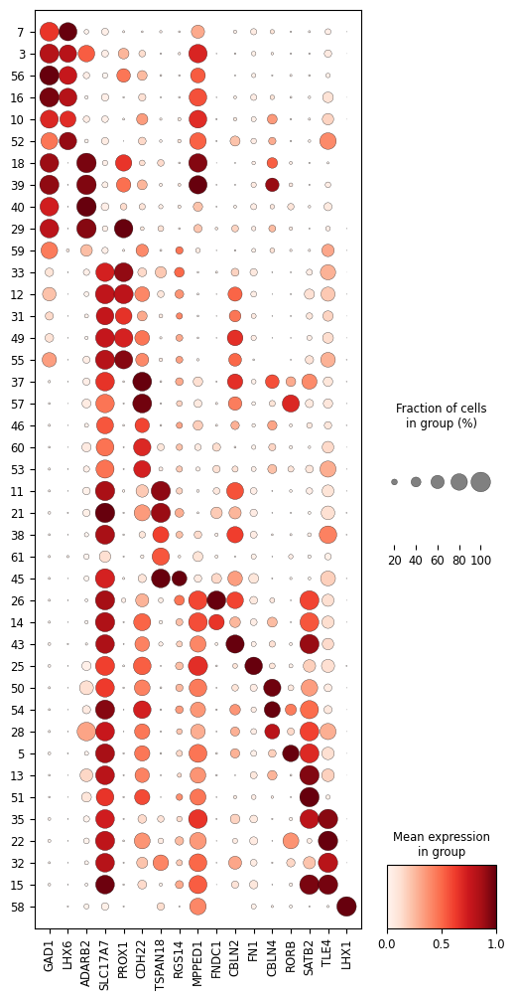

In [149]:
sc.pl.dotplot(adata_nrn2, detailed_markers+['LHX1'], groupby="k_5_louvain", standard_scale="var",
              categories_order=clus_order_focused, figsize=(6,12))

In [134]:
overlap_df = mdata.loc[adata_nrn2.obs.index,:]
overlap_df['k_5_louvain'] = overlap_df['k_5_louvain'].astype('str').astype('category')
test_df = overlap_df.groupby(["k_5_louvain","scvi_leiden_k10"], observed=True).size().to_frame("n_cells")
test_df['log_cells'] = np.log10(test_df['n_cells'])
pivot = pd.pivot_table(test_df, values="log_cells",index=["scvi_leiden_k10"], columns=["k_5_louvain"], fill_value=0)

/tmp/ipykernel_85375/2550867485.py:5: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pivot = pd.pivot_table(test_df, values="log_cells",index=["scvi_leiden_k10"], columns=["k_5_louvain"], fill_value=0)


<Axes: xlabel='k_5_louvain', ylabel='scvi_leiden_k10'>

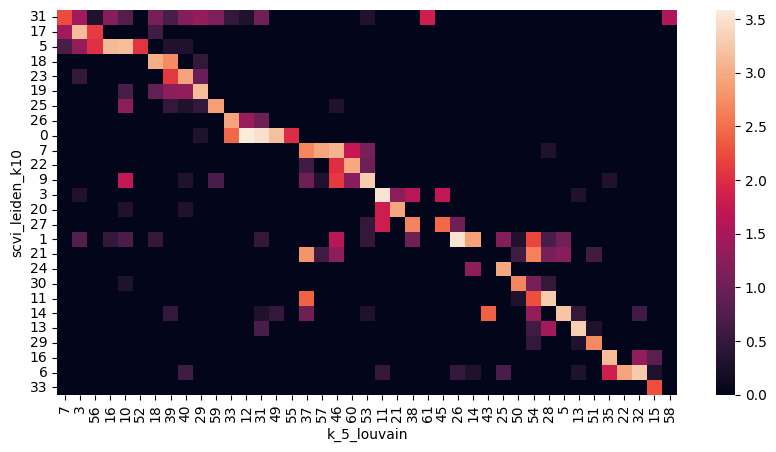

In [154]:
fig, ax = plt.subplots(figsize=(10, 5))
sns.heatmap(pivot.loc[scvi_order,clus_order_focused])

In [ ]:
#look at k_5_louvain = 37 (matches with scvi_leiden_k10 clusters 7 (HATA), 21 (subiculum), 11 (prosubiculum))
#look at k_5_louvain = 61
#look at k_5_louvain = 42 (matches with scvi_leiden_k10 clusters 14 (L4/RORB)
#look at k_5_louvain = 54 (matches with scvi_leiden_k10 clusters 1 (CA1), 21 (subiculum), and 11 (prosubiculum)

In [171]:
adata_inh = adata_nrn2[adata_nrn2.obs['prelim_celltypes'].isin(['GABAergic','VGLUT1-'])]

In [180]:
adata_inh.obs.groupby('k_5_louvain',observed=True).size()
#3, 7, 10, 16, 18, 29, 39, 40, 52, 56, 58, 59, 61

k_5_louvain
3     1448
4        1
7      210
10    1476
12       2
16    1316
18    1080
21       1
29    1440
31      11
33       3
35       1
37       1
39     685
40     869
46       2
49       1
52     116
53       2
56     239
58      36
59     776
61      69
dtype: int64

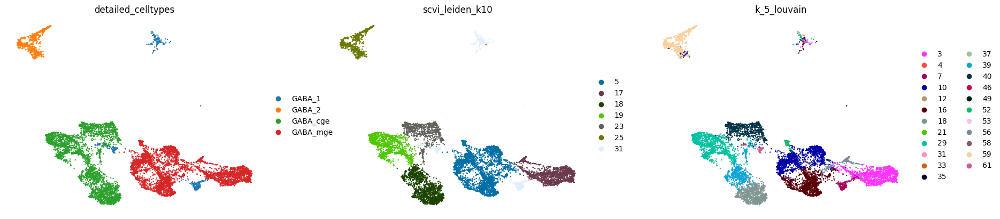

In [173]:
sc.pl.umap(adata_inh, color=["detailed_celltypes","scvi_leiden_k10","k_5_louvain"],
           ncols=3, frameon=False)

In [ ]:
### gaba mge
#k_5_louvain 3 = LHX6, ADARB2, ID2, CCK, NOS1 (scvi_leiden_k10 = 17)
#k_5_louvain 10 = LHX6, TAC1, NPY, SST (scvi_leiden_k10 = 5)
#k_5_louvain 52 = LHX6, NOS1 (scvi_leiden_k10 = 5)
#k_5_louvain 56 = overclustered

#gaba cge
#k_5_louvain 40 = ADARB2, CNR1, CCK (scvi_leiden_k10 = 23)
#k_5_louvain 29 = ADARB2, CALB2, VIP (scvi_leiden_k10 = 19)
#k_5_louvain 39 = ADARB2, LAMP5, RELN, SST (scvi_leiden_k10 = 18)
#k_5_louvain 18 = ADARB2, LAMP5, RELN, ID2, CCK (scvi_leiden_k10 = 18)

#gaba 2
#k_5_louvain 59 = ADARb2, PENK (scvi_leiden_k10 = 25)

#gaba 1
#k_5_louvain 7 = LHX6 C1QL1 (scvi_leiden_k10 = 31)
#k_5_louvain 16 = LHX6, TAC1, PVALB (scvi_leiden_k10 = 31)
#k_5_louvain 61 = overclustered (scvi_leiden_k10 = 31)
#k_5_louvain 58 = LHX1 Cajal/ overclustered (scvi_leiden_k10 = 31)

In [ ]:
sc.pl.umap(adata_inh, color=["detailed_celltypes","scvi_leiden_k10","k_5_louvain"],
           ncols=3, frameon=False)

In [175]:
mdata.groupby(['k_5_louvain','superfine.cell.class'],observed=True).size()

k_5_louvain  superfine.cell.class
1            Oligo.1                 3694
2            Micro.1                 1643
3            LAMP5.MGE               1586
4            Thal                      35
5            L5.1                    1811
6            Micro.2                 1937
7            C1QL1                    231
8            Astro.1                 1943
9            Oligo.2                 3093
10           SST                     1737
11           CA3.1                   3410
12           GC.1                    4316
13           L2/3.1                  2187
14           ProS                     858
15           L6.1                     212
16           PV.FS                   1429
18           LAMP5.CGE               1208
19           Endo.1                  1797
20           Astro.2                  274
21           MC                       928
22           Sub.2                    897
24           OPC                     1605
25           Sub.1                    994


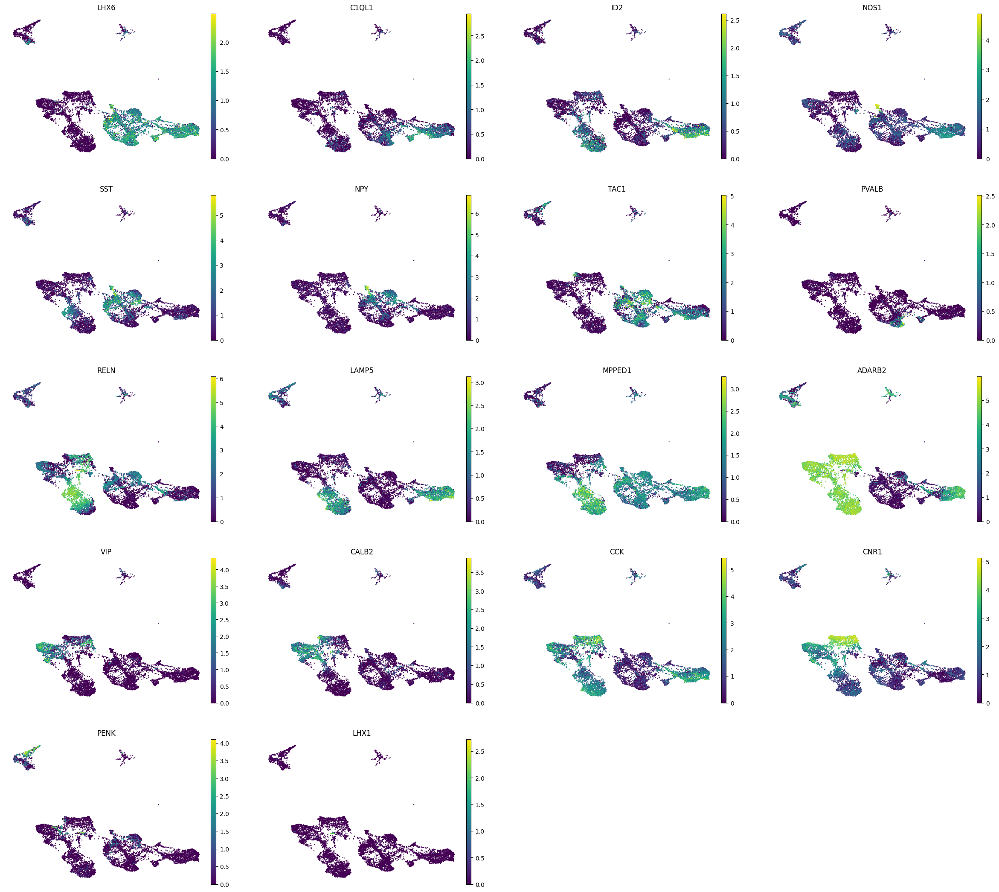

In [179]:
sc.pl.umap(adata_inh, color=["LHX6","C1QL1","ID2","NOS1","SST","NPY","TAC1","PVALB",
                   "RELN","LAMP5","MPPED1",
                   "ADARB2","VIP","CALB2","CCK","CNR1","PENK","LHX1"],
           ncols=4, frameon=False)


In [163]:
adata_sub = adata_nrn2[adata_nrn2.obs['detailed_celltypes'].isin(['HAT','Sub','ProS'])]

In [ ]:
adata_sub.obs['k_5_c37'] = adata_sub.obs['k_5_louvain']=="37"
adata_sub.obs['k_5_c37'] = adata_sub.obs['k_5_louvain']=="37"

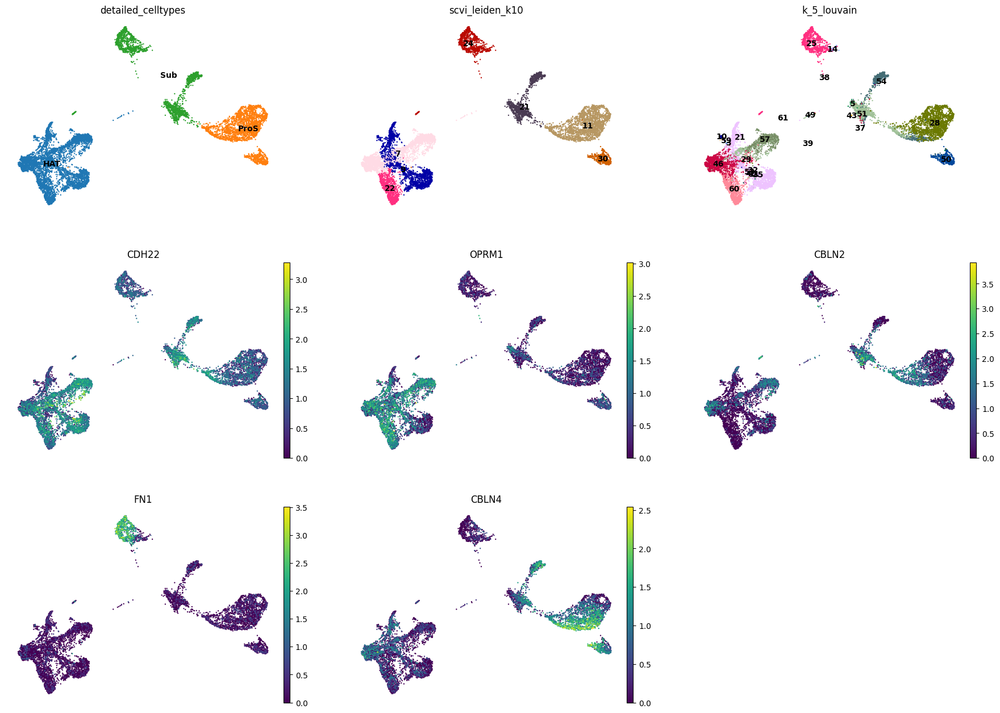

In [170]:
sc.pl.umap(adata_sub, color=["detailed_celltypes","scvi_leiden_k10","k_5_louvain","CDH22","OPRM1","CBLN2","FN1","CBLN4"],
           ncols=3, legend_loc="on data", frameon=False)

In [158]:
tmp = adata_filt[adata_filt.obs['k_5_louvain']=='37']

In [ ]:
detailed_markers2 = [
                   #other GABA markers: NXPH1, GRIK1, RELN, ADARB2, RGS12, CNR1 are all from Ayhan
                   # I added C1QL1, LHX6, TAC1 based on this paper/figure https://www.nature.com/articles/s41586-018-0654-5/figures/5
                   ### more on TAC1 C1QL1 https://www.nature.com/articles/s41467-020-20328-4
                   # I added SST, CCK, ID2, NPY
                   "LHX6","C1QL1","ID2","NOS1","SST","NPY","TAC1",
                   ##"GRIK1",
                   "RELN",
                   ##"ADARB2", "RGS12",
                   "VIP","CALB2","CCK","CNR1","PENK",
                   #PENK https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8210463/
                    "SLC17A7","PROX1",
                   "CDH22","OPRM1",#HAT, CDH22 Fig 4: https://www.sciencedirect.com/science/article/pii/S1567133X10000815?via%3Dihub
                   #"KCNQ5",
                   "TSPAN18","CARTPT",#CA3 markers from Erik's list
                   "RGS14",#CA2 marker from Erik's list 
                   #"MPPED1", #CA1 and cortical marker https://pubmed.ncbi.nlm.nih.gov/20503375/
                   "FNDC1","FIBCD1","COL5A2",#CA1 markers from Erik's list
                   #subiculum and prosubiclum, from: https://www.cell.com/cell-reports/fulltext/S2211-1247(20)30601-X
                   "CBLN2",#subiculum pyramidal superficial
                   "FN1",# subiculum pyramidal
                    "NTNG2",#prosubiculum
                   "CBLN4",#Prosubiculum pyramidal, superficial
                   "RORB",#L4 https://elifesciences.org/articles/52370.pdf
                   "SATB2", #callosal projection neurons https://pubmed.ncbi.nlm.nih.gov/18255030/
                   #SATB2 superficial cortical layers Fig 1 https://www.cell.com/neuron/fulltext/S0896-6273(07)01017-3
                   "CDH12",#Figure 6D https://www.sciencedirect.com/science/article/pii/S1567133X10000815?via%3Dihub
                   "TLE4",#corticothalamic neuron https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10542749/
                   "TBR1",
]

In [41]:
adata_filt.obs['fine_cell_class'] = "none"
adata_filt.obs.loc[mdata[mdata.adata].index,'fine_cell_class'] = mdata[mdata.adata]["fine.cell.class"]

In [151]:
adata_filt.obs['superfine_cell_class'] = "none"
adata_filt.obs.loc[mdata[mdata.adata].index,'superfine_cell_class'] = mdata[mdata.adata]["superfine.cell.class"]

In [198]:
adata_filt.obs['k_5_louvain'] = "none"
adata_filt.obs.loc[mdata[mdata.adata].index,'k_5_louvain'] = mdata[mdata.adata]["k_5_louvain"].astype('str')

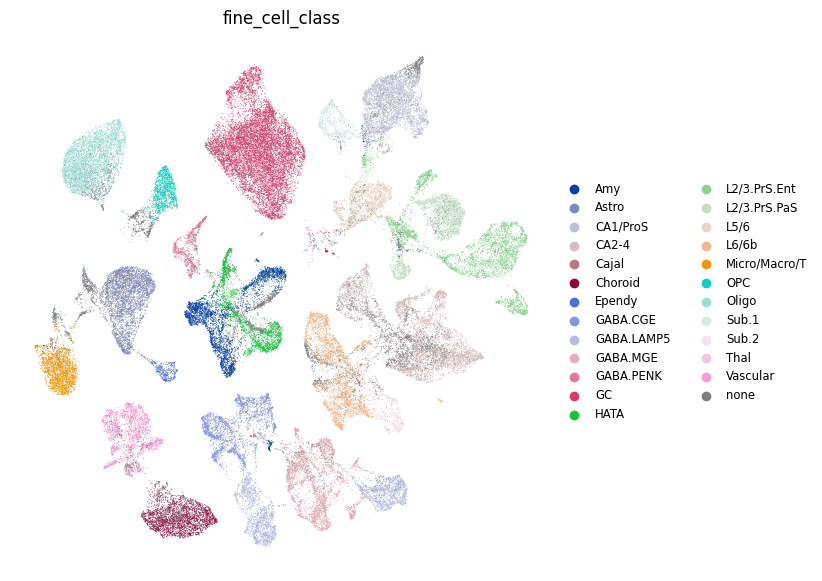

In [42]:
with plt.rc_context({"figure.figsize": (7, 7)}):
    sc.pl.umap(adata_filt, color=["fine_cell_class"], legend_fontsize="small",
               ncols=1, frameon=False)

#### JT cell types onto EN

In [258]:
mdata['scvi_leiden_k10'] = "none"
mdata.loc[mdata.adata,'scvi_leiden_k10'] = adata_filt.obs.loc[adata_filt.obs.EN_final,'scvi_leiden_k10']

In [120]:
mdata['prelim'] = "none"
mdata.loc[mdata.adata,'prelim'] = adata_filt.obs.loc[adata_filt.obs.EN_final,'prelim_celltypes']

mdata['detailed'] = "none"
mdata.loc[mdata.adata,'detailed'] = adata_filt.obs.loc[adata_filt.obs.EN_final,'detailed_celltypes']

mdata['detailed2'] = "none"
mdata.loc[mdata.adata,'detailed2'] = adata_filt.obs.loc[adata_filt.obs.EN_final,'detailed_celltypes2']

In [177]:
overlap_df = mdata[mdata.adata]
test_df = overlap_df.groupby(["mid.cell.class","prelim"], observed=True).size().to_frame("n_cells")
test_df['log_cells'] = np.log10(test_df['n_cells'])
pivot = pd.pivot_table(test_df, values="log_cells",index=["prelim"], columns=["mid.cell.class"], fill_value=0)

<Axes: xlabel='mid.cell.class', ylabel='prelim'>

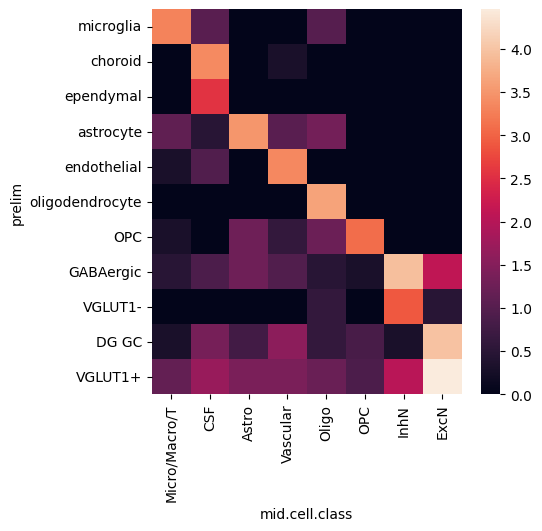

In [182]:
fig, ax = plt.subplots(figsize=(5, 5))
sns.heatmap(pivot.loc[['microglia','choroid','ependymal','astrocyte','endothelial','oligodendrocyte','OPC',
                        'GABAergic','VGLUT1-','DG GC','VGLUT1+'],
['Micro/Macro/T','CSF','Astro','Vascular','Oligo','OPC','InhN','ExcN']])

In [89]:
overlap_df = mdata[mdata.adata]
test_df2 = overlap_df.groupby(["fine.cell.class","detailed"], observed=True).size().to_frame("n_cells")
test_df2['log_cells'] = np.log10(test_df2['n_cells'])
pivot2 = pd.pivot_table(test_df2, values="log_cells",index=["detailed"], columns=["fine.cell.class"], fill_value=0)

In [88]:
jt_order = ['microglia','choroid','ependymal','astrocyte','endothelial','oligodendrocyte','OPC',
            'DG GC',
            "GABA_C1QL1","GABA_MGE_SST.TAC1.NPY","GABA_MGE_ID2.NOS1","GABA_RELN","GABA_VIP.CALB2","GABA_CCK","GABA_PENK",
            "HAT",
            "CA3","CA2","CA1",
            "Sub","ProS",
            "Pyr_superficial","Pyr_deep"
           ]

In [85]:
en_order = ['Micro/Macro/T','Choroid','Ependy','Astro','Vascular','Oligo','OPC','GC',
            'Cajal','GABA.MGE','GABA.LAMP5','GABA.CGE','GABA.PENK',
            'Amy','HATA','Thal',
'CA2-4','CA1/ProS','Sub.1','Sub.2',
            'L2/3.PrS.Ent','L2/3.PrS.PaS',
           'L5/6','L6/6b']

<Axes: xlabel='fine.cell.class', ylabel='detailed'>

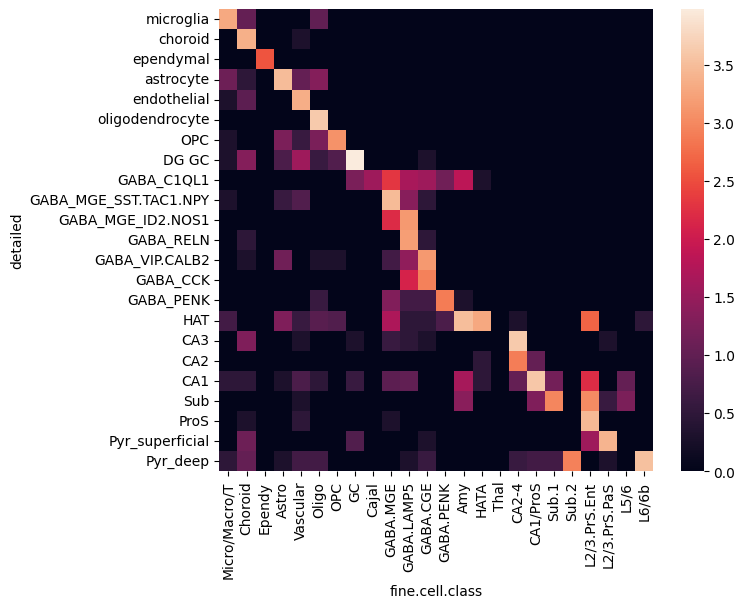

In [91]:
fig, ax = plt.subplots(figsize=(7, 6))
sns.heatmap(pivot2.loc[jt_order,en_order])

In [263]:
overlap_df = mdata[mdata.adata]
overlap_df['k_5_louvain'] = overlap_df['k_5_louvain'].astype('str')
test_df3 = overlap_df.groupby(["k_5_louvain","scvi_leiden_k10"], observed=True).size().to_frame("n_cells")
test_df3['log_cells'] = np.log10(test_df3['n_cells'])
pivot3 = pd.pivot_table(test_df3, values="log_cells",index=["scvi_leiden_k10"], columns=["k_5_louvain"], fill_value=0)

/tmp/ipykernel_1449125/2794495062.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  overlap_df['k_5_louvain'] = overlap_df['k_5_louvain'].astype('str')


In [264]:
overlap_df.k_5_louvain

key
1c-scp-AAACGAAAGGTGAGCT-1      2
1c-scp-AAACGAACACAAAGTA-1      1
1c-scp-AAACGAACAGGGACTA-1      1
1c-scp-AAACGAATCGACGCGT-1      3
1c-scp-AAACGCTGTAACGTTC-1      1
                              ..
39c-scp-TTTGGTTAGCGTATAA-1    31
39c-scp-TTTGGTTTCAGAGCAG-1    49
39c-scp-TTTGTTGAGTATGGCG-1    12
39c-scp-TTTGTTGGTGATTGGG-1    30
39c-scp-TTTGTTGGTTCAAAGA-1    11
Name: k_5_louvain, Length: 64251, dtype: object

In [136]:
jt_order3 = ['microglia','choroid','ependymal','astrocyte','astrocyte_2','endothelial','oligodendrocyte','OPC',
            'GC','GC_active',
            "GABA_C1QL1","GABA_MGE_ID2.NOS1","GABA_MGE_SST.TAC1.NPY",
             "GABA_RELN","GABA_CCK","GABA_VIP.CALB2","GABA_PENK",
            "HAT_1","HAT_2","HAT_3",
            "CA3","CA3_MC","CA2","CA1",
             "ProS","ProS_NTNG2",
            "Sub_FN1","Sub_CBLN2",
            "Pyr_sup1","Pyr_sup2","Pyr_L4","Pyr_deep1","Pyr_deep2","Pyr_deep3"
           ]

In [235]:
obj1 = mdata.groupby(['superfine.cell.class','k_5_louvain'], observed=True).size()
en_dict = dict(zip(obj1.index.get_level_values(0),obj1.index.get_level_values(1).astype('str')))

In [236]:
en_dict

{'AHi.1': '46',
 'AHi.2': '57',
 'AHi.3': '60',
 'AHi.4': '61',
 'Astro.1': '8',
 'Astro.2': '20',
 'Astro.3': '27',
 'C1QL1': '7',
 'CA1': '26',
 'CA2': '45',
 'CA3.1': '11',
 'CA3.2': '38',
 'COP': '44',
 'CORT': '52',
 'CP.1': '34',
 'CP.2': '36',
 'CP.3': '62',
 'CRABP1': '56',
 'CXCL14': '39',
 'Cajal': '58',
 'Endo.1': '19',
 'Endo.2': '47',
 'Ependy': '48',
 'GC.1': '12',
 'GC.2': '31',
 'GC.3': '33',
 'GC.4': '49',
 'GC.5': '55',
 'HATA': '53',
 'HTR3A': '40',
 'L2/3.1': '13',
 'L2/3.2': '28',
 'L2/3.3': '37',
 'L2/3.4': '50',
 'L2/3.5': '51',
 'L2/3.6': '54',
 'L5.1': '5',
 'L5.2': '43',
 'L6.1': '15',
 'L6.2': '32',
 'L6b': '35',
 'LAMP5.CGE': '18',
 'LAMP5.MGE': '3',
 'MC': '21',
 'Macro/Tcell': '42',
 'Micro.1': '2',
 'Micro.2': '6',
 'OPC': '24',
 'Oligo.1': '1',
 'Oligo.2': '9',
 'PC/SMC': '30',
 'PENK': '59',
 'PV.FS': '16',
 'ProS': '14',
 'SST': '10',
 'Sub.1': '25',
 'Sub.2': '22',
 'Thal': '4',
 'VIP': '29',
 'VLMC': '41'}

In [213]:
en_order3 = ['Macro/Tcell','Micro.2','Micro.1',
           'CP.1','CP.2','CP.3','Ependy',
           'Astro.1','Astro.2','Astro.3',
           'Endo.1','Endo.2','PC/SMC','VLMC',
           'Oligo.1','Oligo.2','OPC','COP',
           'GC.3','GC.1','GC.2','GC.4','GC.5',
             'Cajal',
           'C1QL1',
             'LAMP5.MGE','CRABP1','PV.FS','SST',
             'CORT',
            'LAMP5.CGE','CXCL14','HTR3A',
           'VIP','PENK',
           'AHi.2','AHi.1','AHi.3','HATA','AHi.4','Thal',
           'CA3.1','MC','CA3.2','CA2','CA1',
           'ProS',
              'L2/3.6','L2/3.2','L2/3.4',
              'Sub.1','L2/3.3',
           'L2/3.1','L2/3.5',
            'L5.1','L5.2',
            'L6b','L6.2','Sub.2','L6.1'
             #'ProS','Sub.1','Sub.2',
           # 'L2/3.6','L2/3.2',
           #'L2/3.1','L2/3.3','L2/3.4','L2/3.5',
           # 'L5.1','L5.2',
           # 'L6b','L6.2','L6.1'
           ]

In [215]:
clus_order = [en_dict.get(key) for key in en_order3]

In [ ]:
clus_order = ['6','2','42', #microglia
             '34','36','62', #choroid
              '48',#ependy
              '8','27','20',#astro
              '19','30','41','47'#endo/vasc
              '1','9',#oligo
              '24','44',#OPC
              '33',#GC
              '12','13','49','55',#gc active
              '58','61',
             ]

<Axes: xlabel='k_5_louvain', ylabel='scvi_leiden_k10'>

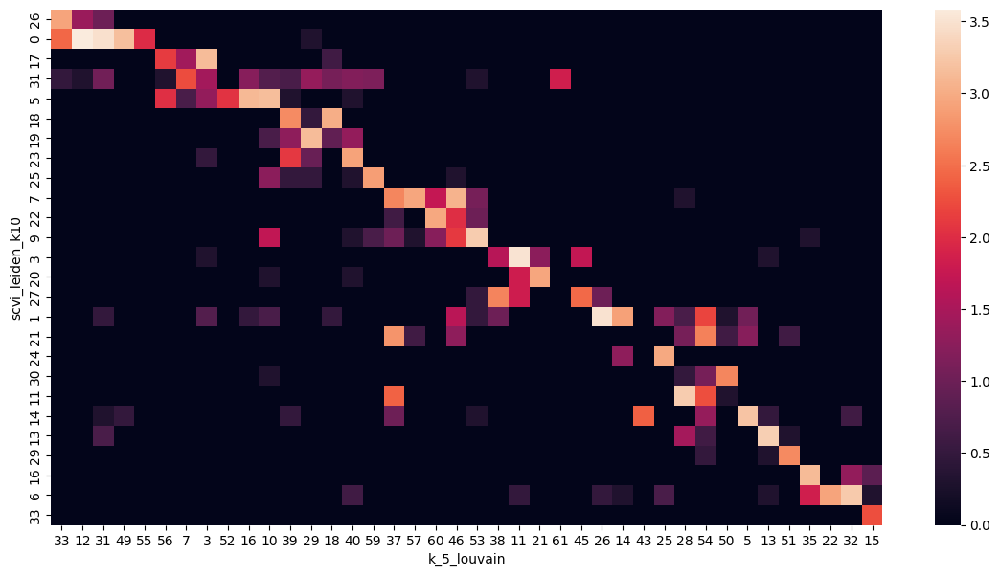

In [272]:
fig, ax = plt.subplots(figsize=(14, 7))
sns.heatmap(pivot3.loc[jt_order_rev,clus_order_focused])

In [149]:
en_focused = ['CA3.1','MC','CA3.2','CA2','CA1',
           'ProS',
              'L2/3.6','L2/3.2','L2/3.4',
              'Sub.1','L2/3.3',
           'L2/3.1','L2/3.5',
            'L5.1','L5.2',
            'L6b','L6.2','Sub.2','L6.1']

<Axes: xlabel='superfine.cell.class', ylabel='detailed2'>

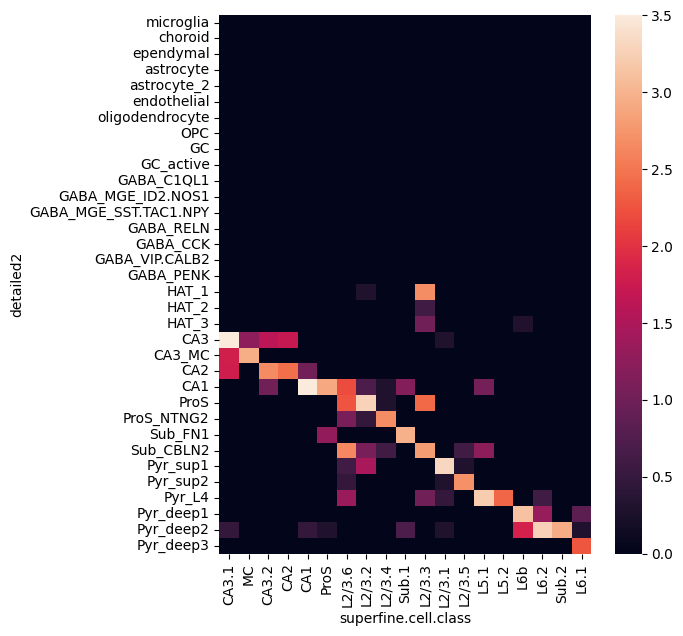

In [150]:
fig, ax = plt.subplots(figsize=(6, 7))
sns.heatmap(pivot3.loc[jt_order3,en_focused])

In [199]:
adata_nrn2 = adata_filt[adata_filt.obs['superfine_cell_class'].isin(en_focused)]

/users/jthompso/.conda/envs/snPy/lib/python3.10/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


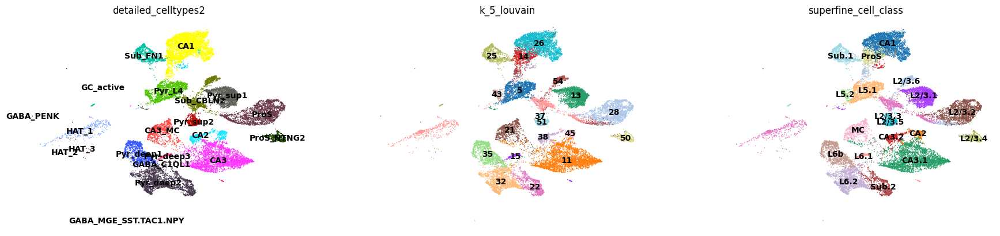

In [200]:
sc.pl.umap(adata_nrn2, color=["detailed_celltypes2","k_5_louvain","superfine_cell_class"],
           ncols=3, legend_loc="on data", frameon=False)

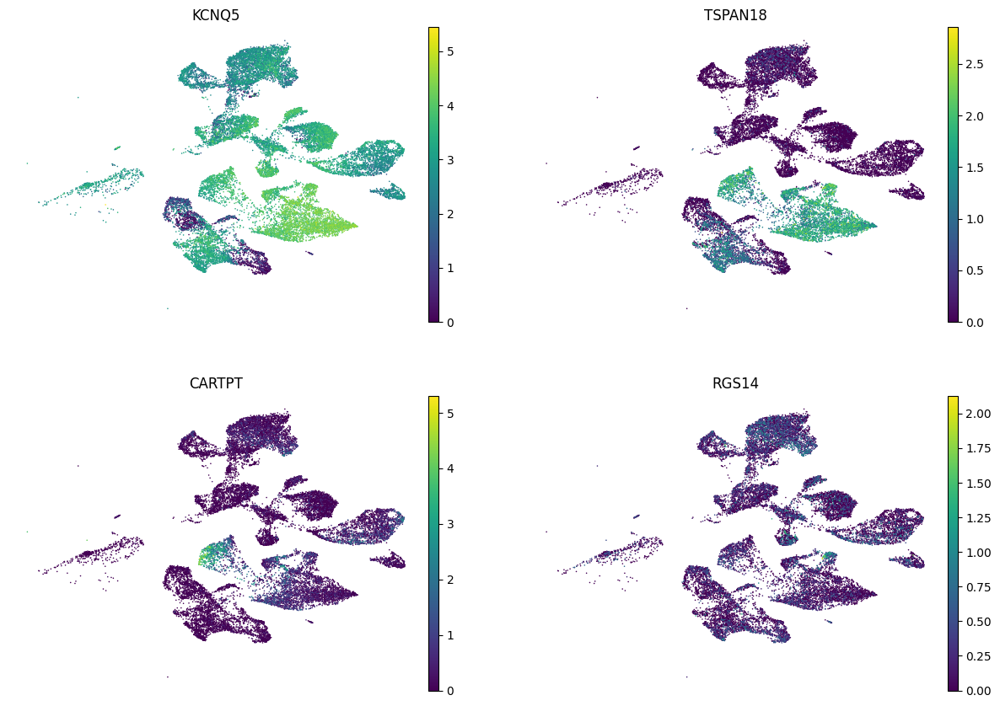

In [190]:
sc.pl.umap(adata_nrn2, color=["KCNQ5","TSPAN18","CARTPT","RGS14"],
           ncols=2, frameon=False)

In [184]:
en_order4 = ['GC.3','GC.1','GC.2','GC.4','GC.5',
             #'Cajal',
             'CRABP1','C1QL1',
             'LAMP5.MGE','CORT',
             'PV.FS','SST',
            'CXCL14','VIP','LAMP5.CGE','HTR3A',
           'PENK',
           'AHi.2','AHi.3','AHi.1','HATA',#'Thal',
           'CA3.2','CA3.1','MC','AHi.4',
             'CA2','CA1',
             'ProS','Sub.1',
              'L2/3.6','L2/3.2','L2/3.4',
              'L2/3.3',
           'L2/3.1','L2/3.5',
            'L5.1','L5.2',
            'L6b','L6.2','Sub.2','L6.1']

In [218]:
adata_nrn2 = adata_filt[adata_filt.obs['superfine_cell_class'].isin(en_order4)]

In [237]:
clus_order = [en_dict.get(key) for key in en_order4]

In [248]:
clus_order_focused = [
    '33','12','31','49','55',#GCs
    '56','7','3','52','16','10',#GABA LHX6+ aka MGE
    '39','29','18','40',#GABA other aka CGE
    '59',#GABA PENK
    '37',#i'm guessing this maps to my cluster 21 because high CDH22 and higher than other clusters CBLN2 (but not as high as my cluster 21
    '57','60','46','53',#AHI/HAT
    '38',#HAT/CA3?
    '11','21',#CA3
    '61',#ca3?
    '45',#CA2
    '26','14',#CA1
    '43',#sub cbln2 and pros ntng2
    '25',#sub fn1
    '28','54','50',#pros cbln4
    '5',#l4
    '13','51',#pyr superficial
    '35','22','32','15'#pyr deep
]

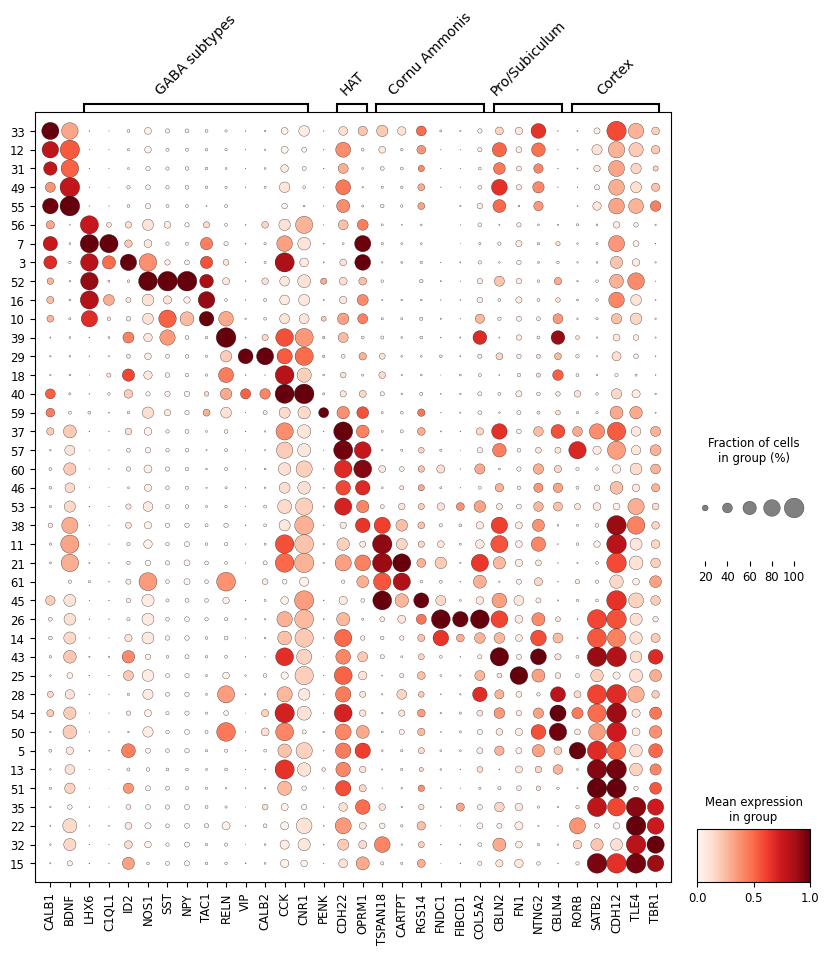

In [255]:
sc.pl.dotplot(adata_nrn2, 
              prelim_markers3, groupby="k_5_louvain", standard_scale="var", 
              var_group_positions=[(2,13),(15,16),(17,22),(23,26),(27,31)],
              var_group_labels=["GABA subtypes","HAT","Cornu Ammonis","Pro/Subiculum","Cortex"],
              var_group_rotation=45,
              categories_order=clus_order_focused, figsize=(10,10))

In [251]:
prelim_markers3 = ["CALB1","BDNF",
                   "LHX6",
                   "C1QL1","ID2","NOS1","SST","NPY","TAC1",
                   "RELN",
                   "VIP","CALB2","CCK","CNR1","PENK",
                   "CDH22","OPRM1",
                   "TSPAN18","CARTPT",
                   "RGS14",
                   "FNDC1","FIBCD1","COL5A2",
                   "CBLN2",#subiculum pyramidal superficial
                   "FN1",# subiculum pyramidal
                   "NTNG2",#pros
                   "CBLN4",#Prosubiculum pyramidal, superficial
                   "RORB",#L4 https://elifesciences.org/articles/52370.pdf
                   "SATB2", #callosal projection neurons https://pubmed.ncbi.nlm.nih.gov/18255030/
                   #SATB2 superficial cortical layers Fig 1 https://www.cell.com/neuron/fulltext/S0896-6273(07)01017-3
                   "CDH12",#Figure 6D https://www.sciencedirect.com/science/article/pii/S1567133X10000815?via%3Dihub
                   "TLE4",#corticothalamic neuron https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10542749/
                   "TBR1",
]
#"CUX2","SATB2","TLE4","FEZF2"

In [ ]:
#CA1 and ProS markers in EN L2/3.6
#ProS markers in EN L2/3.4